In [1]:
#imports
import random
import multiprocessing
from multiprocessing import Pool
from datetime import date
import snscrape.modules.twitter as sntwitter
import pandas as pd
import numpy as np
from wordcloud import WordCloud
import re
import matplotlib.pyplot as plt
import seaborn as sns
# plt.style.use('fivethirtyeight')
import nltk
from nltk.stem.snowball import SnowballStemmer
from nltk.corpus import stopwords
import concurrent.futures

from copy import deepcopy
from pprint import pprint



import os

# import spacy
# nlp = spacy.load("en_core_web_sm")

import matplotlib.image as mpimg

from pandas.plotting import table 










from matplotlib_venn_wordcloud import venn3_wordcloud,venn2_wordcloud
from wordcloud import WordCloud,ImageColorGenerator
from matplotlib_venn import venn3, venn3_circles,venn2_circles,venn2,venn2_unweighted



In [2]:


#read in top 1,000 celebs
url='https://gist.githubusercontent.com/mbejda/9c3353780270e7298763/raw/1bfc4810db4240d85947e6aef85fcae71f475493/Top-1000-Celebrity-Twitter-Accounts.csv'
celebs=pd.read_csv(url)
celebs=celebs.to_dict()


In [3]:





# Below are two ways of scraping using CLI commands.
# Comment or uncomment as you need. If you currently run the script as is it will scrape both queries
# then output two different csv files.

# Query by username
# # Setting variables to be used in format string command below


# tweet_count =100 #this number is the last n tweets
# dflist=[]
# dfdict={}
# count=-1*tweet_count
# celeblen=len(celebs.get('twitter').keys())
# numindex=list(range(0,tweet_count*celeblen))
# len(numindex)


# dictcount=0
# errornames=[]

# for c in range(0,celeblen):
#     dictcount+=1
#     count=count+tweet_count
#     maxnum=count+tweet_count

#     twitter_handle=list(celebs.get('twitter')[c])
#     name=list(celebs.get('name')[c])
    
#     cur=numindex[count:maxnum]
   
#     #create Series to append the current handle to the dataframe
#     handleseries={i:twitter_handle for i in cur}       
#     #create Series to append the current name to dataframe   
#     nameseries={i:name for i in cur}
  

  
#     try:
#         # Using OS library to call CLI commands in Python
#         os.system("snscrape --jsonl --max-results {} twitter-search 'from:{}'> user-tweets.json".format(tweet_count, twitter_handle))

#          # Reads the json generated from the CLI command above and creates a pandas dataframe
#          #if there is an error then it will just move to the next  
#         tweets_df1 = pd.read_json('user-tweets.json', lines=True).set_index(keys=pd.Index(cur)).to_dict()
    
#         if dictcount==1:
#             tweets_df1.update({'name':nameseries})
#             tweets_df1.update({'handle':handleseries})
#             dfdict={**dfdict,**tweets_df1}
#         else:
#             for key in dfdict.keys():
#                 tweets_df1.update({'name':nameseries})
#                 tweets_df1.update({'handle':handleseries})
#                 a=tweets_df1.get(key)
#                 b=dfdict.get(key)
#                 c={**a,**b}
#                 dfdict.update({key:c})
#     except:
#         errornames.append(name)
#         print(errornames)
#         pass
            
        

    


   
    


# dataframe=pd.DataFrame(dfdict).sort_index()
# cols=list(set(dataframe.columns)-{'name','handle'})
# cols.insert(0,'name')
# cols.insert(0,'handle')
# dataframe=dataframe[cols]

# pd.to_pickle(dataframe,"./fivezerominpull.pkl")



# Warning you need to uncomment above to scrape and create the pickle. 

## Your speed my vary but it took 45 mins for the scrape

## The code below directly below is to the big scrape

In [4]:
# Read from the pickle and then display the unique file

dataframe=pd.read_pickle("./fivezerominpull.pkl")
dataframe.name.nunique()


885

In [5]:
ptypeurl='https://raw.githubusercontent.com/twitter-personality-predictor/twitter-personality-predictor/main/twitter_handles.csv'

ptypes=pd.read_csv(ptypeurl);ptypes
newcols=[]
for x in ptypes.columns.to_list():
    y=x.lower()
    newcols.append(y)

ptypes.columns=newcols
ptypes['handle']=ptypes.twitter
ptypes.drop(columns='twitter',inplace=True)
ptypes.name=ptypes.name.str.lower();ptypes

dataframe.name=dataframe.name.str.lower();dataframe





,handle,name,content,quotedTweet,outlinks,retweetCount,hashtags,sourceLabel,sourceUrl,tcooutlinks,...,mentionedUsers,quoteCount,coordinates,replyCount,id,cashtags,inReplyToTweetId,user,likeCount,renderedContent
0,katyperry,katy perry,if you wanna know why any human is they way th...,None,None,4575,None,Twitter for iPhone,http://twitter.com/download/iphone,None,...,None,623,NaN,1210,1586844179363250176,NaN,NaN,"{'_type': 'snscrape.modules.twitter.User', 'us...",29840,if you wanna know why any human is they way th...
1,katyperry,katy perry,"wait, if it’s called a “feed” are we literally...",None,None,881,None,Twitter for iPhone,http://twitter.com/download/iphone,None,...,None,179,NaN,603,1586251933479739393,NaN,NaN,"{'_type': 'snscrape.modules.twitter.User', 'us...",10502,"wait, if it’s called a “feed” are we literally..."
2,katyperry,katy perry,😉 https://t.co/70hbuuC39d,"{'_type': 'snscrape.modules.twitter.Tweet', 'u...",[https://twitter.com/perryorgasm_/status/15857...,2217,None,Twitter for iPhone,http://twitter.com/download/iphone,[https://t.co/70hbuuC39d],...,None,114,NaN,575,1585998214368722949,NaN,NaN,"{'_type': 'snscrape.modules.twitter.User', 'us...",31006,😉 twitter.com/perryorgasm_/s…
3,katyperry,katy perry,heck I pour beer out of my tits (that’s a part...,None,None,297,"[chainedtothealgorithm, therealproblemlolhaha]",Twitter for iPhone,http://twitter.com/download/iphone,None,...,None,34,NaN,100,1585709853367930881,NaN,1.585710e+18,"{'_type': 'snscrape.modules.twitter.User', 'us...",3042,heck I pour beer out of my tits (that’s a part...
4,katyperry,katy perry,The show’s set list is a fun 🎢 through memory...,None,None,336,None,Twitter for iPhone,http://twitter.com/download/iphone,None,...,None,17,NaN,69,1585709755779072000,NaN,1.585709e+18,"{'_type': 'snscrape.modules.twitter.User', 'us...",3654,The show’s set list is a fun 🎢 through memory...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99495,manugavassi,manu gavassi,"É nóis, letras. https://t.co/gGypAe2CF1","{'_type': 'snscrape.modules.twitter.Tweet', 'u...",[https://twitter.com/letras/status/15371337358...,57,None,Twitter for Android,http://twitter.com/download/android,[https://t.co/gGypAe2CF1],...,None,0,NaN,19,1537139164084305920,NaN,NaN,"{'_type': 'snscrape.modules.twitter.User', 'us...",595,"É nóis, letras. twitter.com/letras/status/…"
99496,manugavassi,manu gavassi,Senti lágrimas 🥲❤ https://t.co/aw9IprSRr9,"{'_type': 'snscrape.modules.twitter.Tweet', 'u...",[https://twitter.com/prinuzelly/status/1537132...,38,None,Twitter for Android,http://twitter.com/download/android,[https://t.co/aw9IprSRr9],...,None,2,NaN,25,1537138986334007298,NaN,NaN,"{'_type': 'snscrape.modules.twitter.User', 'us...",440,Senti lágrimas 🥲❤ twitter.com/prinuzelly/sta…
99497,manugavassi,manu gavassi,Manda foto da TV!!!! Tá em qual episódio? http...,"{'_type': 'snscrape.modules.twitter.Tweet', 'u...",[https://twitter.com/profxavierx/status/153713...,30,None,Twitter for Android,http://twitter.com/download/android,[https://t.co/jAWWoNX9vt],...,None,2,NaN,38,1537138787637252098,NaN,NaN,"{'_type': 'snscrape.modules.twitter.User', 'us...",405,Manda foto da TV!!!! Tá em qual episódio? twit...
99498,manugavassi,manu gavassi,Esse eu gostaria de ter roubado. Errei. https:...,"{'_type': 'snscrape.modules.twitter.Tweet', 'u...",[https://twitter.com/gavaxsi/status/1537133732...,42,None,Twitter for Android,http://twitter.com/download/android,[https://t.co/wlZkxS5sem],...,None,1,NaN,29,1537138410812583936,NaN,NaN,"{'_type': 'snscrape.modules.twitter.User', 'us...",547,Esse eu gostaria de ter roubado. Errei. twitte...


In [6]:
dataframe.sourceLabel.value_counts()

Twitter for iPhone      58826
Twitter Web App         11512
Instagram                5823
Twitter for Android      4334
Twitter Web Client       1616
                        ...  
TwitLonger Beta             1
Twitter for  Android        1
OS X                        1
ViralSweep App              1
QWVR                        1
Name: sourceLabel, Length: 70, dtype: int64

In [7]:


a=ptypes.name.values.tolist()
b=ptypes.type.values.tolist()
ptypemap=dict(zip(a,b))
ptypemap
dataframe.dropna(axis=1,inplace=True)
dataframe['type']=dataframe.name.map(ptypemap)



cols=list(set(dataframe.columns)-{'name','handle','type'})
cols.insert(0,'handle')
cols.insert(0,'name')
cols.insert(0,'type')

dataframe=dataframe[cols]
dataframe.dropna(axis=0,inplace=True)



display(pd.DataFrame((dataframe['name'].unique()),index=range(0,len(dataframe['name'].unique()))).T)
display(dataframe[['type','name']].groupby(['type']).nunique().T)






/var/folders/tc/rqcbqynd6g96v17vbqppznm40000gn/T/ipykernel_67221/3421587410.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataframe.dropna(axis=0,inplace=True)


,0,1,2,3,4,5,6,7,8,9,...,589,590,591,592,593,594,595,596,597,598
0,katy perry,justin bieber,taylor swift,rihanna,the countess,justin timberlake,ellen degeneres,britney spears,cristiano ronaldo,kim kardashian west,...,depeche mode,amy schumer,craig ferguson,ayushmann khurrana,birdman,kylie minogue,zedd,troian,juicy j,manu gavassi


type,ENFJ,ENFP,ENTJ,ENTP,ESFJ,ESFP,ESTJ,ESTP,INFJ,INFP,INTJ,INTP,ISFJ,ISFP,ISTJ,ISTP
name,37,60,22,51,66,103,23,50,27,15,11,11,32,49,12,30


In [8]:
dataframe.columns.to_frame().T
cols=['type','name','renderedContent','content']
keep=dataframe[cols];keep


,type,name,renderedContent,content
0,ENFJ,katy perry,if you wanna know why any human is they way th...,if you wanna know why any human is they way th...
1,ENFJ,katy perry,"wait, if it’s called a “feed” are we literally...","wait, if it’s called a “feed” are we literally..."
2,ENFJ,katy perry,😉 twitter.com/perryorgasm_/s…,😉 https://t.co/70hbuuC39d
3,ENFJ,katy perry,heck I pour beer out of my tits (that’s a part...,heck I pour beer out of my tits (that’s a part...
4,ENFJ,katy perry,The show’s set list is a fun 🎢 through memory...,The show’s set list is a fun 🎢 through memory...
...,...,...,...,...
99495,ENFP,manu gavassi,"É nóis, letras. twitter.com/letras/status/…","É nóis, letras. https://t.co/gGypAe2CF1"
99496,ENFP,manu gavassi,Senti lágrimas 🥲❤ twitter.com/prinuzelly/sta…,Senti lágrimas 🥲❤ https://t.co/aw9IprSRr9
99497,ENFP,manu gavassi,Manda foto da TV!!!! Tá em qual episódio? twit...,Manda foto da TV!!!! Tá em qual episódio? http...
99498,ENFP,manu gavassi,Esse eu gostaria de ter roubado. Errei. twitte...,Esse eu gostaria de ter roubado. Errei. https:...


## Aquire is done 


## Prep is below

In [9]:
group1=keep[['type','name','content']].groupby(by=['type','name'])
lista=set(group1.groups.keys())
group2=keep[['type','name']].groupby(by=['type'])
listb=list(set(group2.groups.keys()))
group3=keep[['name','content']].groupby(by=['name'])   
indexbyperson={}
for b in listb:
    g=list(group2.get_group(b).index)
    n=list(group2.get_group(b).name.unique())
    
    ndict={}
    for i in n:
        k=list(group3.get_group(i).index)
        c=list(group3.get_group(i).content)
        ndict.update({i:{'index':k,'content':c}})
    indexbyperson.update({b:{'index':g,'name':ndict}})
    





In [10]:
    

#pdf plumber
#csv.preview
import pandas as pd
#import unicode character database
import unicodedata
#import regular expression operations
import re

#import natural language toolkit
import nltk
from nltk.corpus import words
#import our aquire


#import our stopwords list
from nltk.corpus import stopwords
from copy import deepcopy



In [11]:
more_stopwords = ['like', 'im', 'think', 'dont', 'people', 'know', 'one', 'get', 'really','thing',
                  'would', 'time', 'type', 'make', 'friend', 'ive', 'feel', 'much', 'love',
                 'say', 'way', 'see', 'thing', 'want', 'thing', 'good', 'something', 'lot',
                  'also', 'go', 'always', 'even', 'well', 'someone','https','com','co',',',"'"]



stops=stopwords.words(['french','german','english','spanish','portuguese'])+ more_stopwords






pd.to_pickle(stops,'stopwords.pkl')










def stopfilter(text,stop_words_extend_reduce=["'"]):
    'we use symmetric difference so if a is already in stop words then it will be added to our third set else our third set will be missing it'
    #create oujr english stopwords list
    stops = set(pd.read_pickle('stopwords.pkl'))

   
    stop_words_extend_reduce=set(stop_words_extend_reduce)
    stops=stops.symmetric_difference(stop_words_extend_reduce)

    # stops=(stops|stop_words_extend)-exclude_words
    #another way
    
    filtered=list(filter((lambda x: x not in stops), text.split()))
    filtered=' '.join(filtered)

    return filtered






def basic_clean(text,regexfilter=r'[^a-z0-9\'\s]'):
    '''   
    Filters out all special characters if you need to edit then supply a new regex filter 
    
    
    
    
    '''
    #make a copy and begin to transform it
    newtext = text.lower()

    #encode into ascii then decode
    newtext = unicodedata.normalize('NFKD', newtext)\
    .encode('ascii', 'ignore')\
    .decode('utf-8')

    #use re.sub to remove special characters
    newtext = re.sub(fr'{regexfilter}', ' ', newtext)

    
    


    return newtext

    
def lemmatizor(text,regexfilter=r'[^a-z0-9\'\s]'):
    '''    
    
      Takes text, tokenizes it, lemmatizes it
      lemmafiltered=list(filter(lambda x: (len(x)>1 and len(x)<9 and x.isalpha()==True),  lemmatized.split()))
      needs to be commented out after the first run (up to modeling)
      # lemmafiltered=list(filter(lambda x: (len(x)>1 and len(x)<9 and x.isalpha()==True and (x in  total)), lemmatized.split()))
      needs to be un commented commented
    
    
    
    
    
    '''
    total=list(pd.read_pickle('words.pkl'))
    

    #make ready the lemmatizer object
    newtext=tokenizer(text,regexfilter=regexfilter)
    wnl = nltk.stem.WordNetLemmatizer()
    lemmatized=split_apply_join(wnl.lemmatize,newtext)

    # since the average word lenght in English is 4.7 characters we will apply a conservative estimate and drop any word that is larger than 8 characters as it is likely not a word
    # we also recursivley took the set of all words generated then compared that to nltk.corpus.words.words() and used that list as filter this is where total comes from

    # lemmafiltered=list(filter(lambda x: (len(x)>1 and len(x)<9 and x.isalpha()==True and (x in  total)), lemmatized.split()))

    lemmafiltered=list(filter(lambda x: (len(x)>1 and len(x)<9 and x.isalpha()==True),  lemmatized.split()))

    lemmafiltered=' '.join(lemmafiltered)
  
    lemmafiltered=basic_clean(lemmafiltered,regexfilter=regexfilter)

    return lemmafiltered
    
    
def split_apply_join(funct,listobj):
    'helperfuction letters'

    mapped=map(funct, listobj)
    mapped=list(mapped)
    mapped=''.join(mapped)
  
    return mapped




def tokenizer(text,regexfilter=r'[^a-z0-9\'\s]'):
    ''' 
    For a large file just save it locally
    
    
    
    
    
    '''
    newtext=basic_clean(text,regexfilter=regexfilter)
    #make ready tokenizer object
    tokenize = nltk.tokenize.ToktokTokenizer()
    #use the tokenizer
    newtext = tokenize.tokenize(newtext, return_str=True)
    return newtext






In [12]:
num=0
bigdict={'type':{},'name':{},'stoped_lemma':{},'freq':{}}
for i in list(indexbyperson.keys()):
    a=indexbyperson.get(i)
    a=a['name']
    for i1 in list(a.keys()):
        listtonormaliz=str(a[i1]['content'])
        newtext=lemmatizor(listtonormaliz,regexfilter=r'[^a-z0-9\'\s]')
        lemma=newtext
       
        stoped=stopfilter(lemma)
        stoped=stoped.replace('https','').replace('com','').replace('co','').replace(',','').strip()
       
        a[i1].update({'stopped_lemma':stoped})         
     
        cool=dict(pd.Series(stoped.split()).value_counts())
        a[i1].update({'word freq':cool})
        bigdict['type'].update({num:i})
        bigdict['stoped_lemma'].update({num:stoped})
        bigdict['freq'].update({num:cool})
        bigdict['name'].update({num:i1})
        num+=1

    

    


In [13]:
twitterwordslemma=pd.DataFrame(bigdict)
pd.to_pickle(twitterwordslemma,'maindalemma.pkl')
twitterwordslemma=pd.read_pickle('maindalemma.pkl')
twitterwordslemma



,type,name,stoped_lemma,freq
0,ISTP,marshall mathers,wanna fuck shady cause shady fuckin kill ltd e...,"{'shady': 8, 'new': 7, 'tonight': 6, 'day': 6,..."
1,ISTP,ashton kutcher,thanks rich bonkers actually appears foreign g...,"{'usa': 30, 'n': 9, 'france': 9, 'stopped': 8,..."
2,ISTP,kourtney kardashian,poosh n sink best self n poosh n spills n hot ...,"{'n': 69, 'lemme': 14, 'matcha': 8, 'closet': ..."
3,ISTP,kendall jenner,today launch obj new platinum electric electri...,"{'moon': 23, 'partner': 19, 'new': 13, 'n': 9,..."
4,ISTP,snoop dogg,lookn mirror sippin n nlemme snoop dogg stumes...,"{'tha': 13, 'n': 12, 'eminem': 9, 'snoop': 7, ..."
...,...,...,...,...
594,ENTJ,tony robbins,must find progress move forward today blessing...,"{'life': 32, 'amp': 27, 'new': 17, 'need': 13,..."
595,ENTJ,gordon ramsay,tricks treats join us sweet treats street burg...,"{'street': 28, 'kitchen': 16, 'pizza': 14, 'to..."
596,ENTJ,rachel zoe,must never take oneself today million ability ...,"{'xorz': 20, 'life': 16, 'curateur': 12, 'favo..."
597,ENTJ,triple h,game legend begins nbray wyatt live tonight aw...,"{'wwe': 39, 'wwenxt': 31, 'tonight': 16, 'univ..."


In [14]:
num=0
bigdict_type={'type':{},'stoped_lemma':{},'freq':{}}

group1=twitterwordslemma[['stoped_lemma','type']].groupby('type')
group1.groups.keys()
for i in group1.groups.keys():
    
    x=(','.join(list(group1.get_group(i).stoped_lemma.values)).strip())
  
    x=stopfilter(x)
    
   
    y=(pd.Series(x.replace(',',' ').strip().split()).value_counts())
    cool=dict(y)
    bigdict_type['type'].update({num:i})
    bigdict_type['stoped_lemma'].update({num:x})
    bigdict_type['freq'].update({num:cool})
       

    num+=1
    



In [15]:

typeslemma=pd.DataFrame(bigdict_type)
x=str(typeslemma.stoped_lemma.values).replace(',',' ').replace('[','').replace(']','').replace('"','').replace("'",'').replace(',',' ').split()
y=dict(pd.Series(x).value_counts())
aggregatewordfrreq=y
# pd.to_pickle(aggregatewordfrreq,'agglemma.pkl')
num=len(typeslemma)


z=[i.replace(',',' ') for i in typeslemma.stoped_lemma.values]
typeslemma=pd.concat([typeslemma,pd.DataFrame({'type':{num:'COMBINED'},'stoped_lemma':{num:str(z).replace(',',' ').replace('[','').replace(']','').replace('"','').replace("'",'')},'freq':{num:aggregatewordfrreq}})])
pd.to_pickle(typeslemma,'typeslemma.pkl')


In [49]:

typeslemma=pd.read_pickle('typeslemma.pkl')


,type,stoped_lemma,freq
0,ENFJ,wanna human look parents sadly lack thereof pa...,"{'amp': 240, 'thank': 198, 'new': 135, 'today'..."
1,ENFP,year freefire ffxjb gold ladies cannot wait wa...,"{'amp': 310, 'thank': 278, 'new': 222, 'show':..."
2,ENTJ,kindness fund building kinder braver world sta...,"{'new': 134, 'live': 134, 'amp': 108, 'tonight..."
3,ENTP,tomorrow year cheers us youve yet signed weekl...,"{'amp': 213, 'new': 196, 'thank': 139, 'thanks..."
4,ESFJ,spooky science steve spangler safe scares audi...,"{'amp': 276, 'thank': 266, 'happy': 215, 'new'..."
5,ESFP,points sre download free app latest football a...,"{'amp': 489, 'thank': 417, 'new': 376, 'happy'..."
6,ESTJ,thank joe talbot creating world putting bunch ...,"{'new': 140, 'today': 130, 'check': 100, 'than..."
7,ESTP,guess whos hitting amas stage dancing shoes su...,"{'amp': 235, 'new': 214, 'thank': 155, 'happy'..."
8,INFJ,created place gather stories black women honor...,"{'happy': 126, 'thank': 124, 'day': 112, 'new'..."
9,INFP,dragon ball zone beerus less december back jun...,"{'twitter': 113, 'dear': 99, 'friends': 99, 'a..."


In [55]:

extroverteddf=typeslemma[['type','stoped_lemma']].iloc[0:7]
extroverteddf

,type,stoped_lemma
8,INFJ,created place gather stories black women honor...
9,INFP,dragon ball zone beerus less december back jun...
10,INTJ,today proud stand many around world women girl...
11,INTP,math shouldnt limiting students dreams gateway...
12,ISFJ,new ep spotify happy happy happy happy happy m...
13,ISFP,wakanda liftmeup music video liftmeup tonight ...
14,ISTJ,unique film dostojee young bengali director pr...


In [ ]:

introverteddf=typeslemma[['type','stoped_lemma']].iloc[8:15]

In [47]:
freqdict=dict(typeslemma.freq.values[-1])
#set stuff
setlist=[]
for i in typeslemma.freq.values:
    setlist.append(set(i.keys()))

typelist=[]
for i in typeslemma.type.values:
    typelist.append(i)

typessetdict=dict(zip(typelist,setlist))






In [18]:

keys=list(typessetdict.keys())
combined=keys.pop(-1);combined
intersectiondict={}
c=set(typessetdict.get(combined))
keys.reverse()




 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ISTP

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
6142 
intersection combined percent:
13.23%
number unique to 
1295
 percent unique of aggregate union combined:
2.79%
intersection with rest length:
4847 
intersection with rest percent overlap with combined:
10.44%




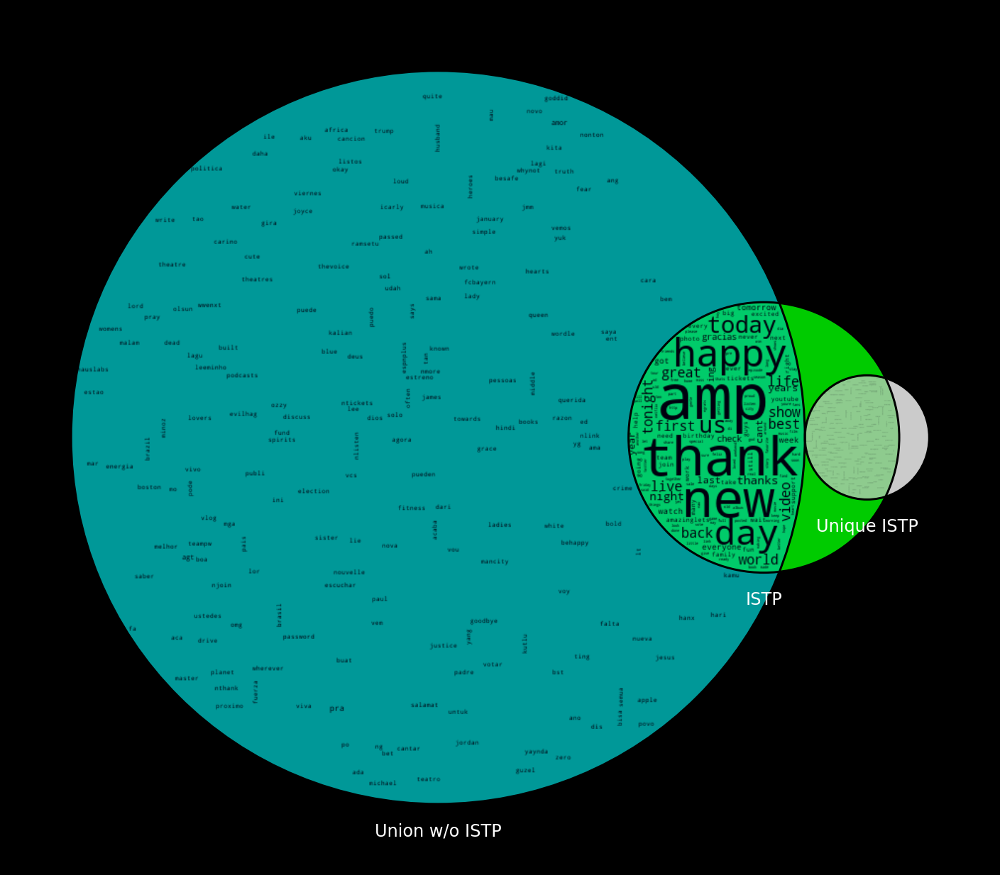

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ISTJ

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
2793 
intersection combined percent:
6.02%
number unique to 
536
 percent unique of aggregate union combined:
1.15%
intersection with rest length:
2257 
intersection with rest percent overlap with combined:
4.86%




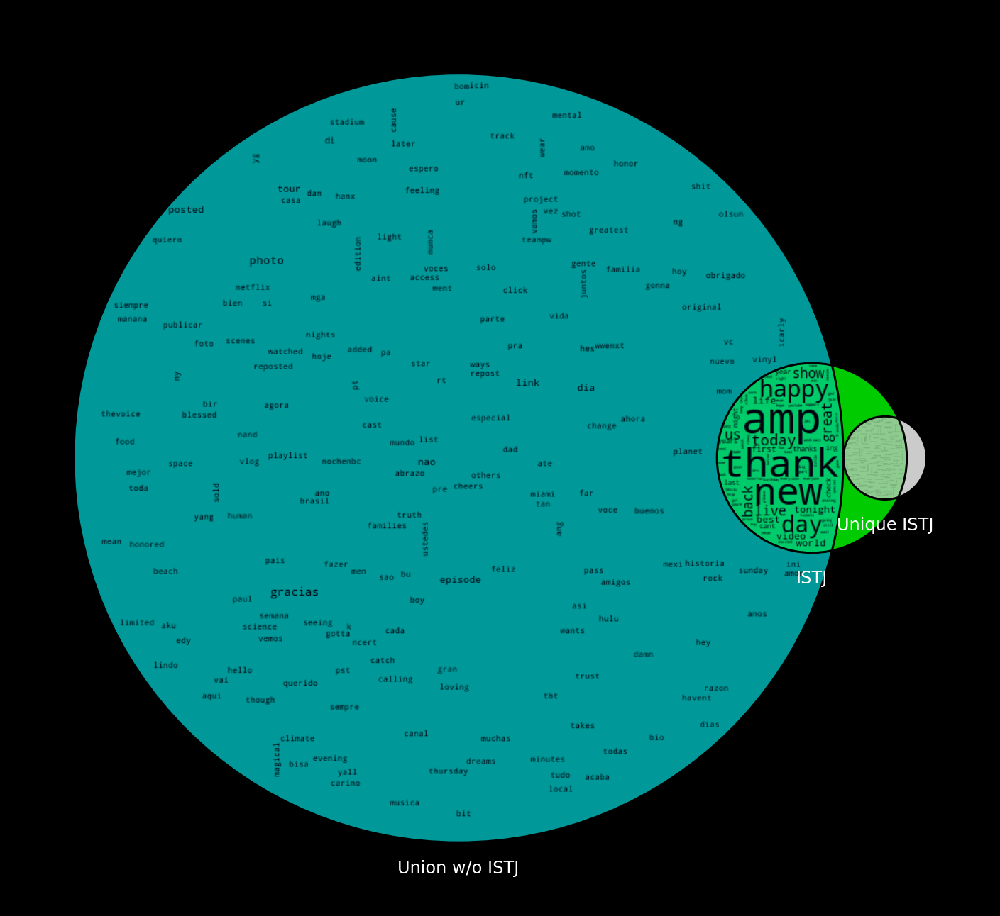

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ISFP

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
8597 
intersection combined percent:
18.52%
number unique to 
2084
 percent unique of aggregate union combined:
4.49%
intersection with rest length:
6513 
intersection with rest percent overlap with combined:
14.03%




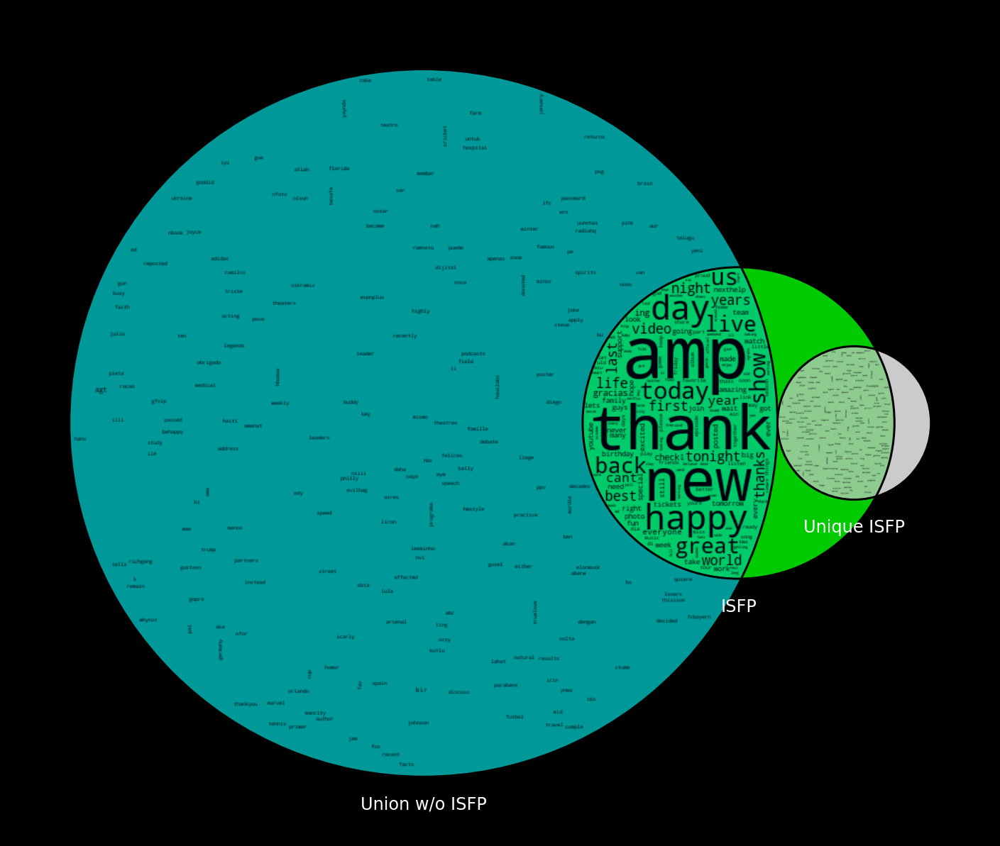

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ISFJ

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
6648 
intersection combined percent:
14.32%
number unique to 
1339
 percent unique of aggregate union combined:
2.88%
intersection with rest length:
5309 
intersection with rest percent overlap with combined:
11.43%




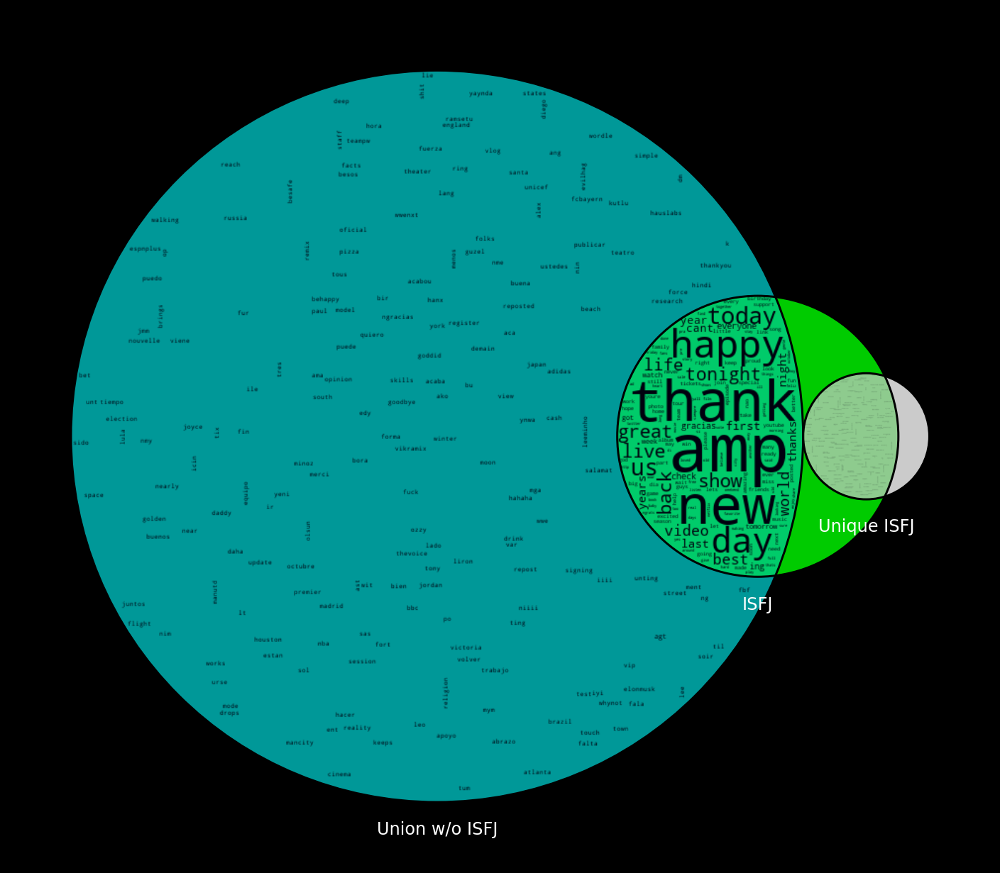

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        INTP

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
3476 
intersection combined percent:
7.49%
number unique to 
570
 percent unique of aggregate union combined:
1.23%
intersection with rest length:
2906 
intersection with rest percent overlap with combined:
6.26%




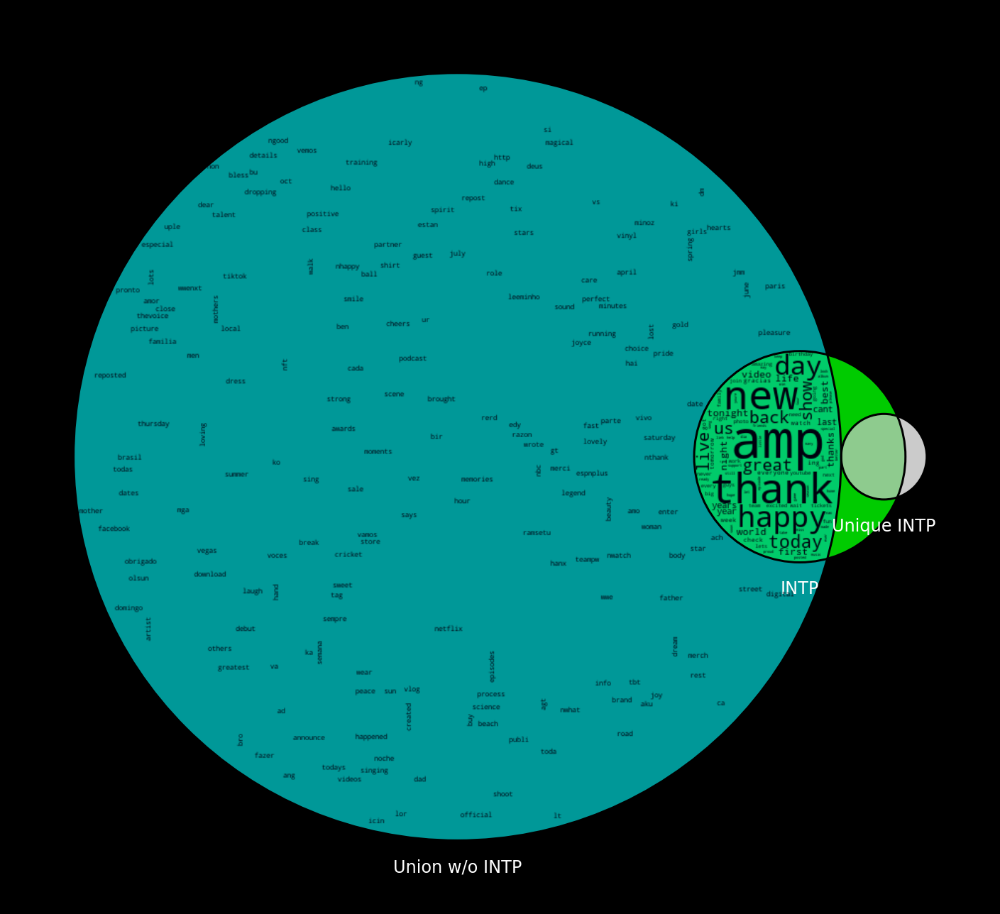

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        INTJ

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
2524 
intersection combined percent:
5.44%
number unique to 
337
 percent unique of aggregate union combined:
0.73%
intersection with rest length:
2187 
intersection with rest percent overlap with combined:
4.71%




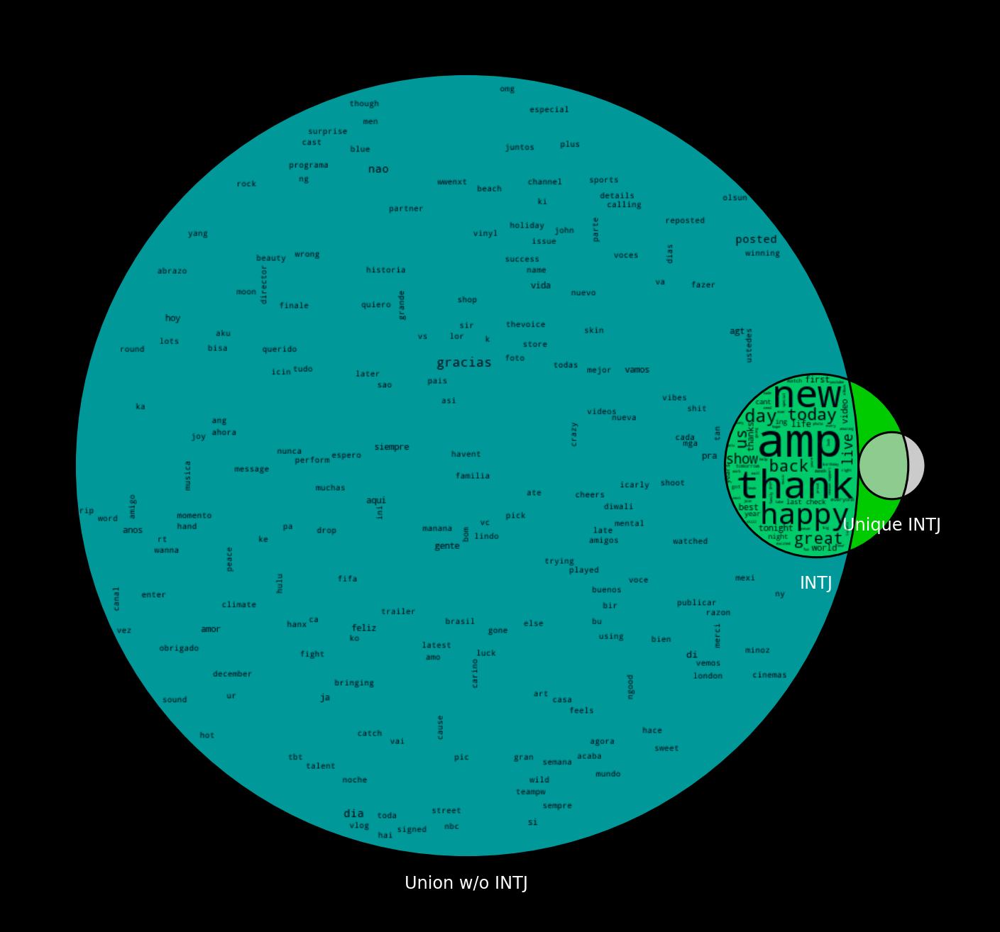

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        INFP

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
4660 
intersection combined percent:
10.04%
number unique to 
867
 percent unique of aggregate union combined:
1.87%
intersection with rest length:
3793 
intersection with rest percent overlap with combined:
8.17%




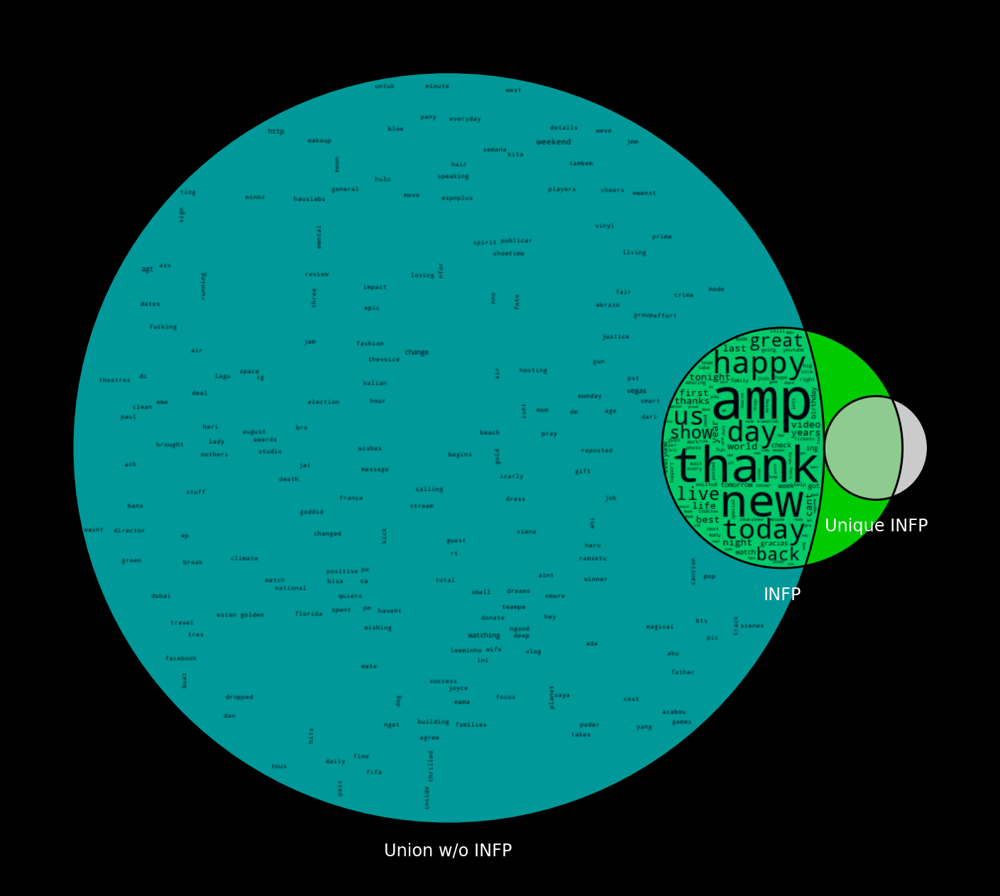

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        INFJ

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
5155 
intersection combined percent:
11.10%
number unique to 
887
 percent unique of aggregate union combined:
1.91%
intersection with rest length:
4268 
intersection with rest percent overlap with combined:
9.19%




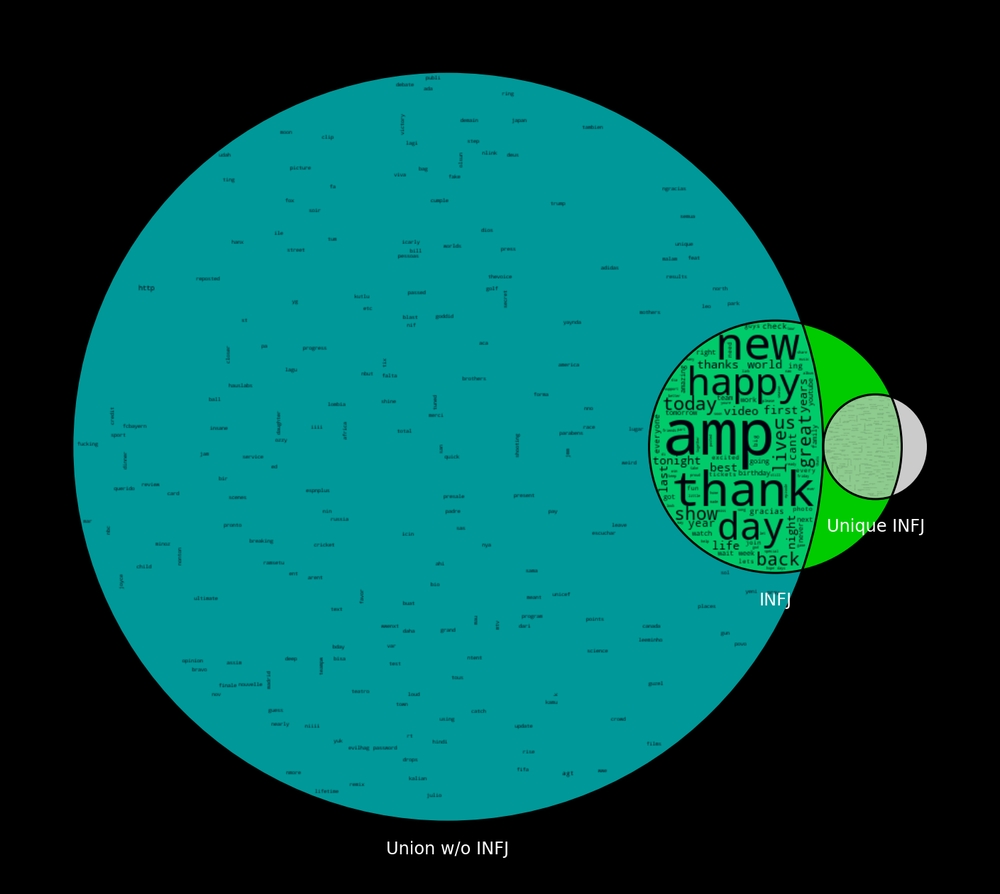

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ESTP

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
9115 
intersection combined percent:
19.63%
number unique to 
2200
 percent unique of aggregate union combined:
4.74%
intersection with rest length:
6915 
intersection with rest percent overlap with combined:
14.89%




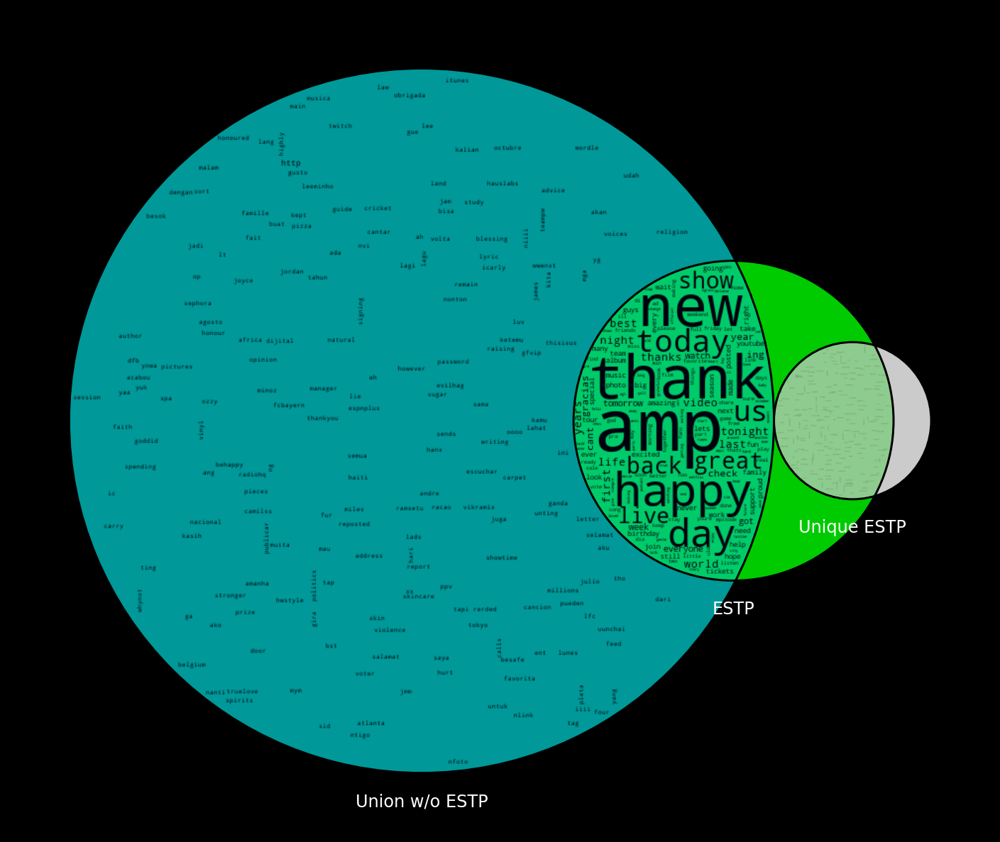

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ESTJ

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
5885 
intersection combined percent:
12.67%
number unique to 
1173
 percent unique of aggregate union combined:
2.53%
intersection with rest length:
4712 
intersection with rest percent overlap with combined:
10.15%




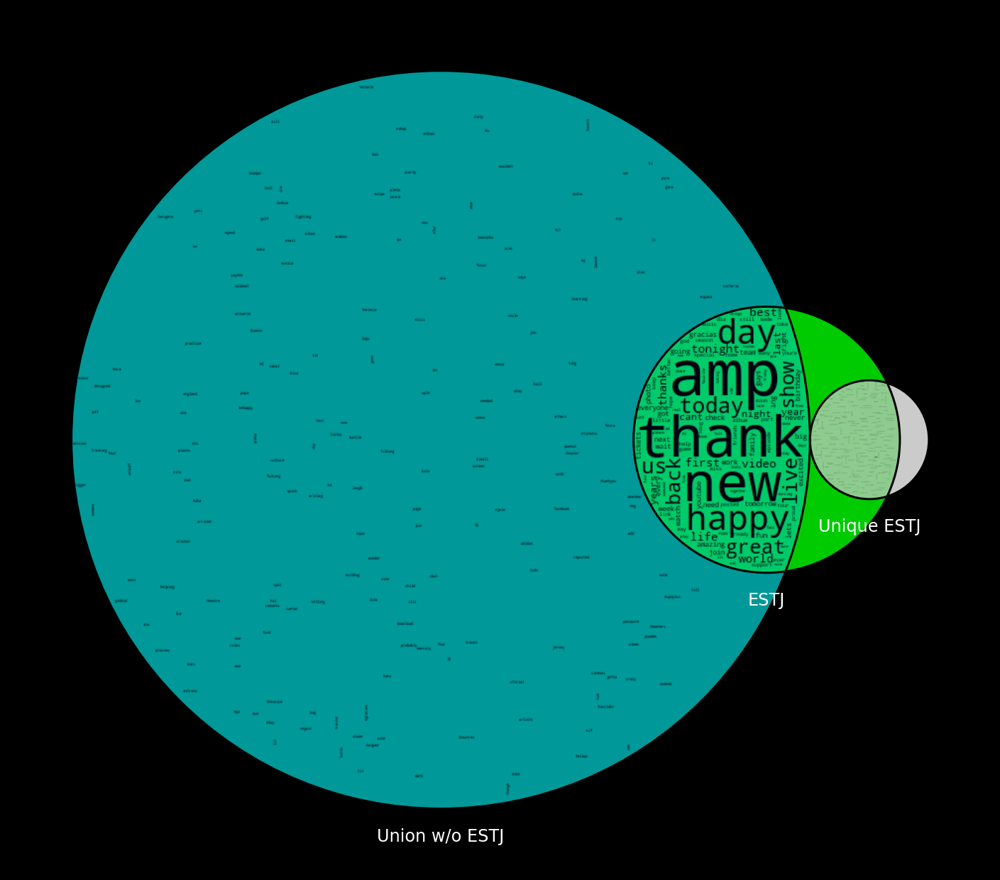

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ESFP

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
15034 
intersection combined percent:
32.38%
number unique to 
4717
 percent unique of aggregate union combined:
10.16%
intersection with rest length:
10317 
intersection with rest percent overlap with combined:
22.22%




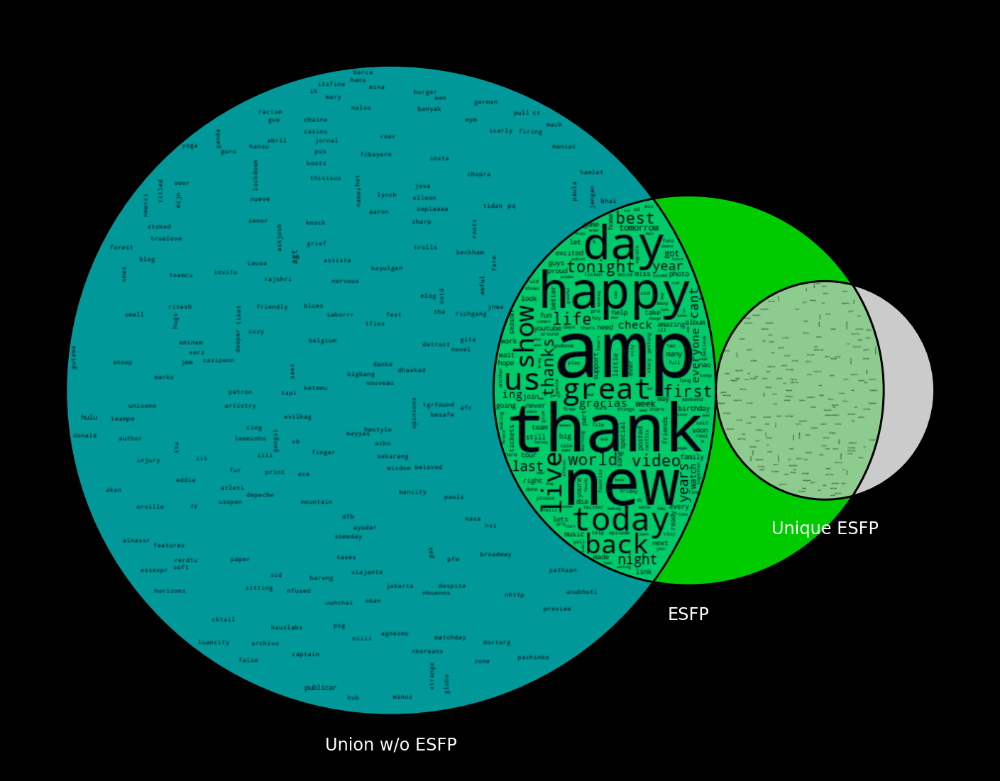

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ESFJ

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
12053 
intersection combined percent:
25.96%
number unique to 
3593
 percent unique of aggregate union combined:
7.74%
intersection with rest length:
8460 
intersection with rest percent overlap with combined:
18.22%




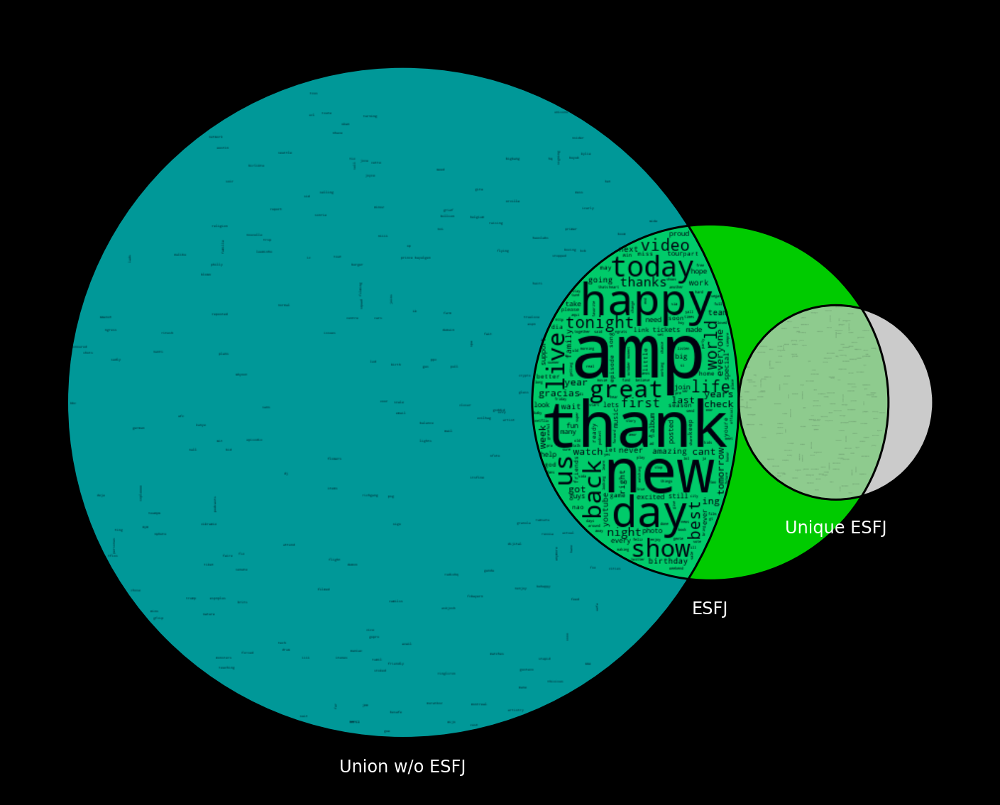

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ENTP

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
10700 
intersection combined percent:
23.05%
number unique to 
3010
 percent unique of aggregate union combined:
6.48%
intersection with rest length:
7690 
intersection with rest percent overlap with combined:
16.56%




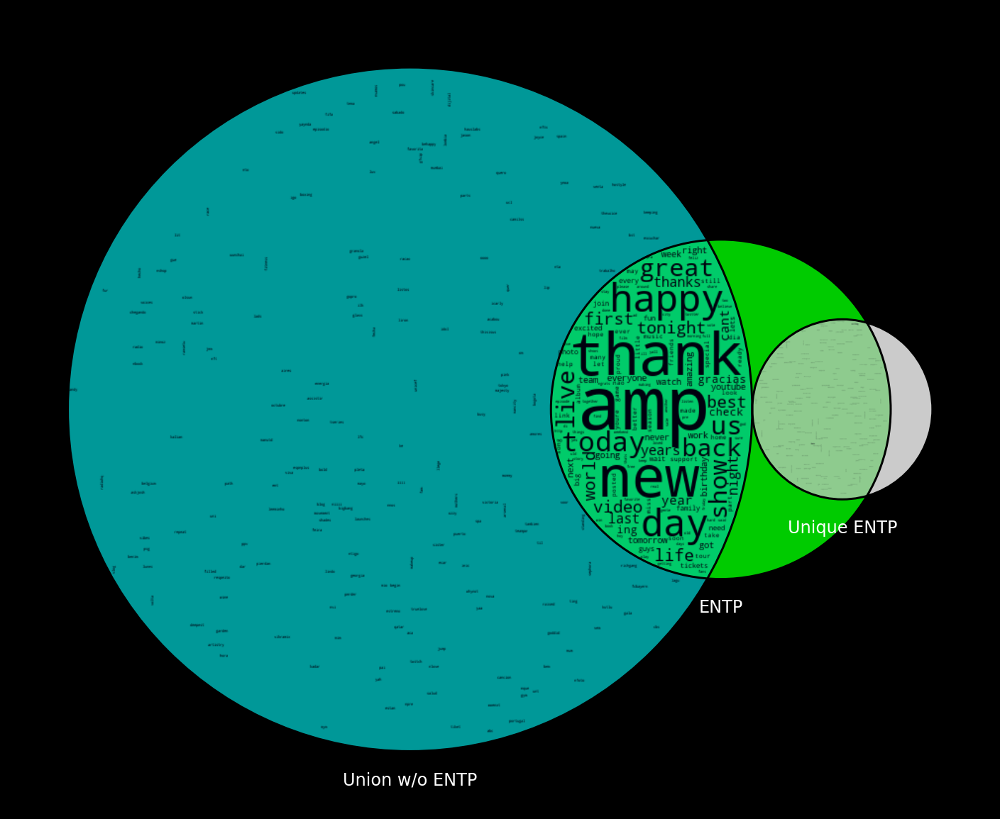

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ENTJ

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
4924 
intersection combined percent:
10.61%
number unique to 
855
 percent unique of aggregate union combined:
1.84%
intersection with rest length:
4069 
intersection with rest percent overlap with combined:
8.76%




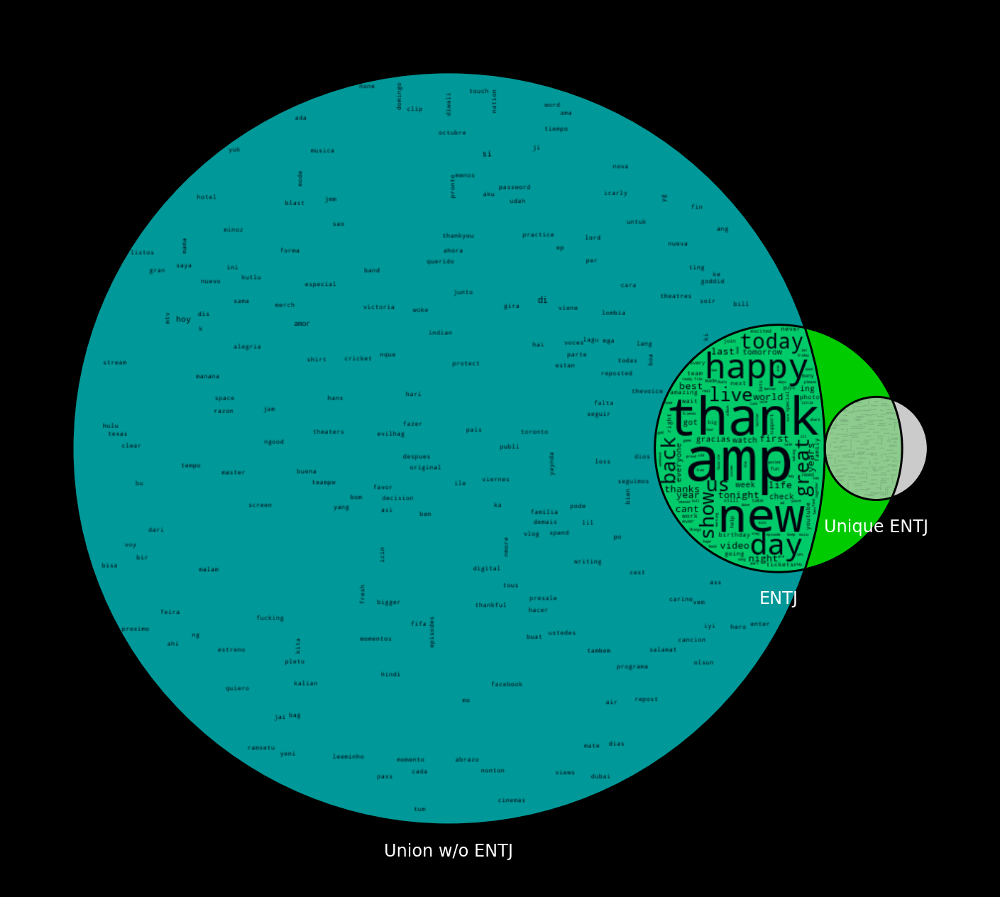

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ENFP

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
10943 
intersection combined percent:
23.57%
number unique to 
3047
 percent unique of aggregate union combined:
6.56%
intersection with rest length:
7896 
intersection with rest percent overlap with combined:
17.01%




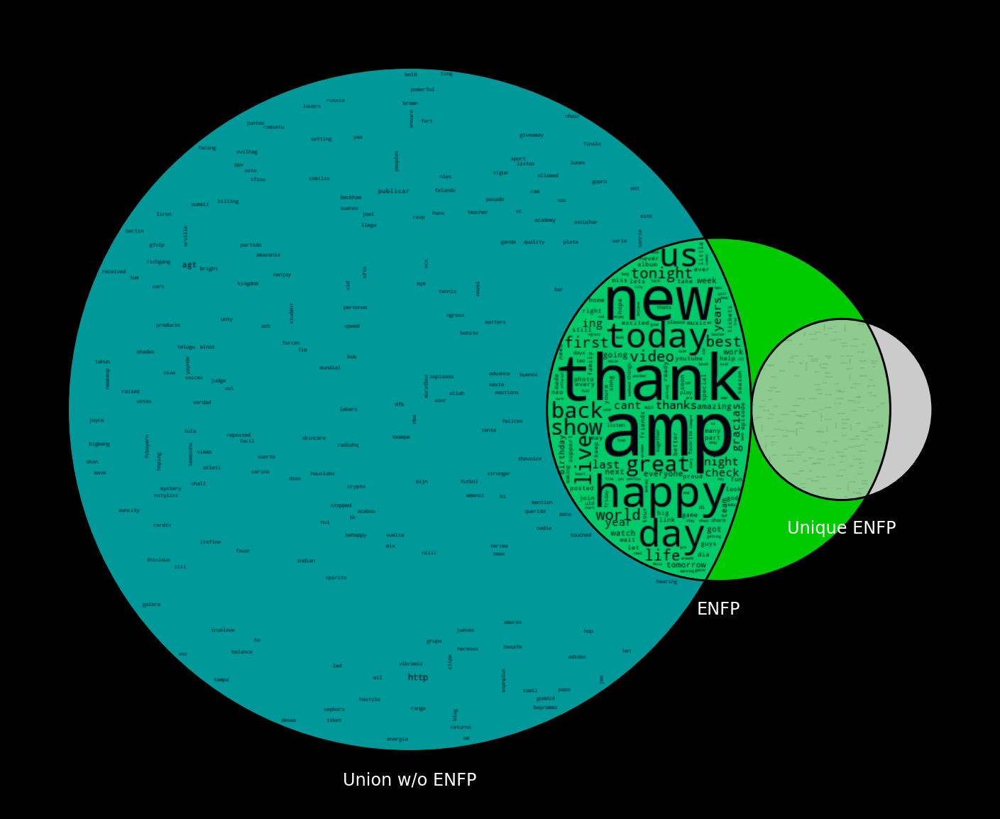

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ENFJ

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
7787 
intersection combined percent:
16.77%
number unique to 
1874
 percent unique of aggregate union combined:
4.04%
intersection with rest length:
5913 
intersection with rest percent overlap with combined:
12.74%




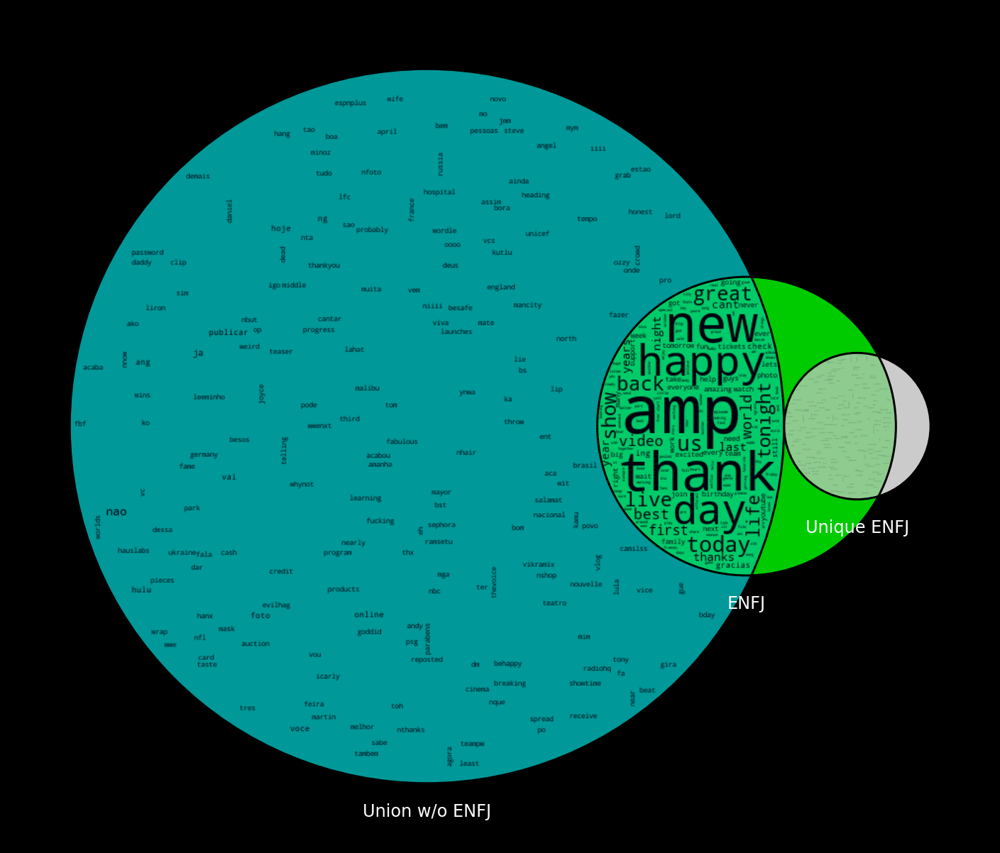

In [33]:
# wordcloud_kwargs=dict(max_font_size=10000, min_font_size=.5)

for i,k in enumerate(keys):
    keyscopy=deepcopy(keys)
    kthset=set(typessetdict.get(k))
    int=c&kthset
    intersectiondict.update({k:int,'intersection count':len(int)})
    kfreq=freqdict.get(k)
   
    keyscopy.pop(i)
    unionwithoutk=set()
    fig,ax=plt.subplots(figsize=(25,25))
    
    [unionwithoutk.update(typessetdict.get(cop))for cop in keyscopy]
    print(f'{"_":>2}'*45,f'\n\n{k:>60}\n\n',f'{"_":>2}'*45,f'\n\nintersection length:\n{len(int)}',f'\nintersection combined percent:\n{(len(int)/len(c))*100:.2f}%')

   

    print(f'number unique to \n{len(kthset-unionwithoutk)}\n',f'percent unique of aggregate union combined:\n{((len(kthset-unionwithoutk))/len(c))*100:.2f}%')
    restint=kthset&unionwithoutk
    print(f'intersection with rest length:\n{len(restint)}',f'\nintersection with rest percent overlap with combined:\n{(len(restint)/len(c))*100:.2f}%\n\n')
    
    venn3_wordcloud([kthset,unionwithoutk,kthset-unionwithoutk], set_colors=['lime','c','w'],set_edgecolors=['0', '0','0'],ax=ax,set_labels=[f'{k}',f'Union w/o {k}',f'Unique {k}'],word_to_frequency=freqdict)#
    plt.show()
   



 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ISTP

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
6142 
intersection combined percent:
13.23%
number unique to 
1295
 percent unique of aggregate union combined:
2.79%
intersection with rest length:
4847 
intersection with rest percent overlap with combined:
10.44%




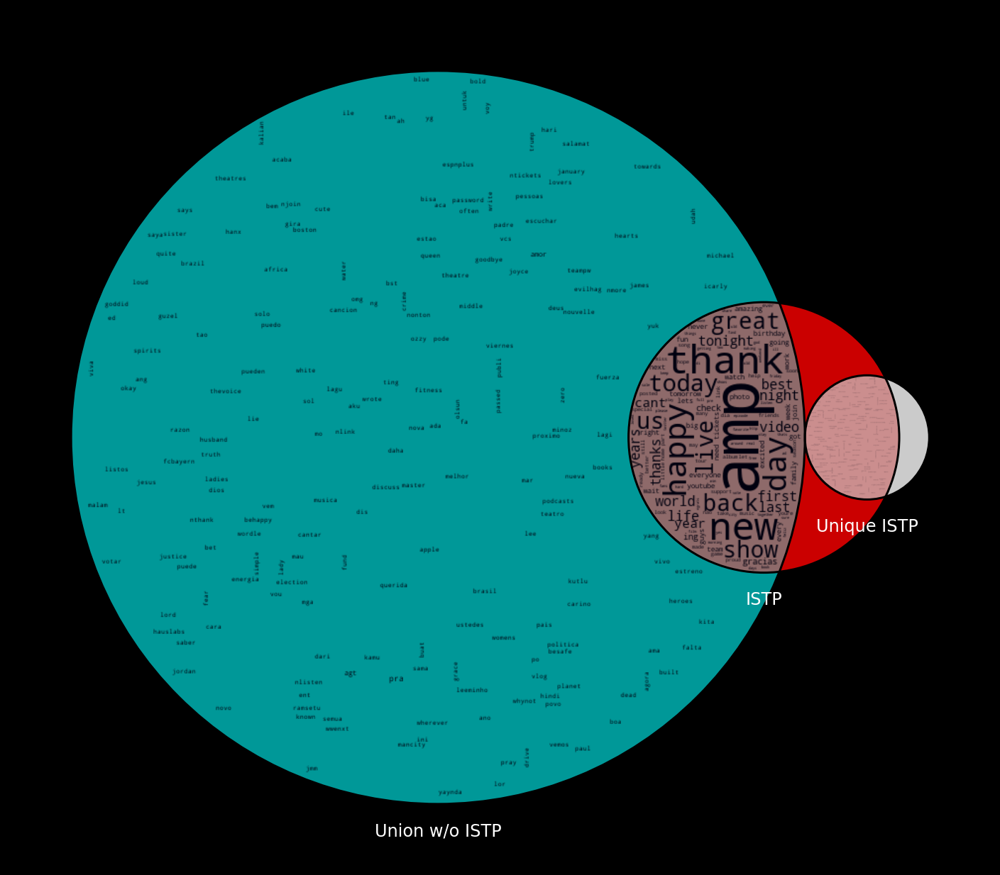

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ISTJ

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
2793 
intersection combined percent:
6.02%
number unique to 
536
 percent unique of aggregate union combined:
1.15%
intersection with rest length:
2257 
intersection with rest percent overlap with combined:
4.86%




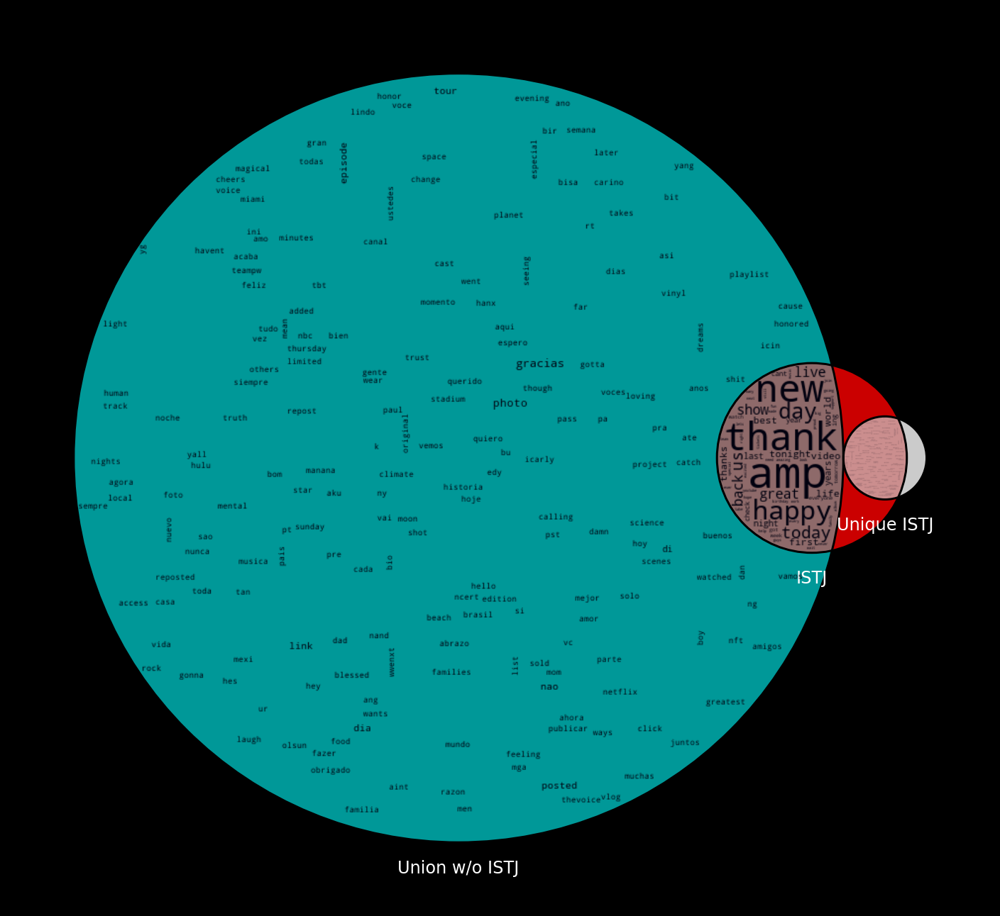

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ISFP

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
8597 
intersection combined percent:
18.52%
number unique to 
2084
 percent unique of aggregate union combined:
4.49%
intersection with rest length:
6513 
intersection with rest percent overlap with combined:
14.03%




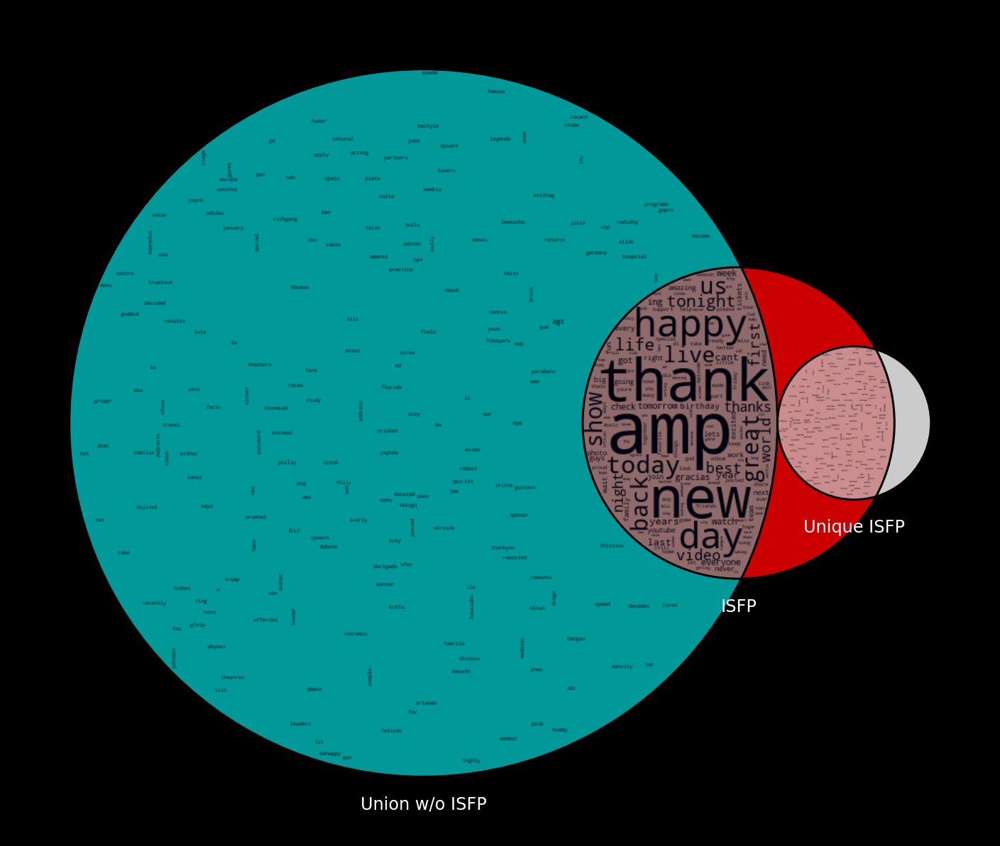

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ISFJ

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
6648 
intersection combined percent:
14.32%
number unique to 
1339
 percent unique of aggregate union combined:
2.88%
intersection with rest length:
5309 
intersection with rest percent overlap with combined:
11.43%




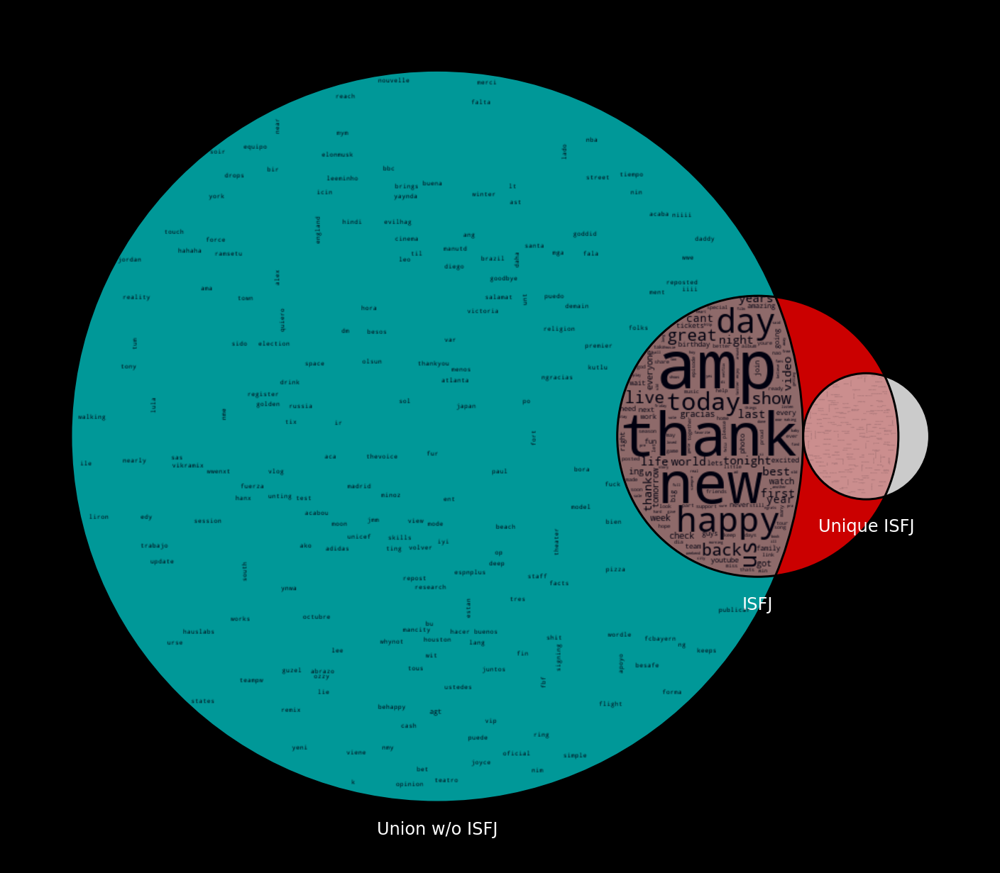

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        INTP

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
3476 
intersection combined percent:
7.49%
number unique to 
570
 percent unique of aggregate union combined:
1.23%
intersection with rest length:
2906 
intersection with rest percent overlap with combined:
6.26%




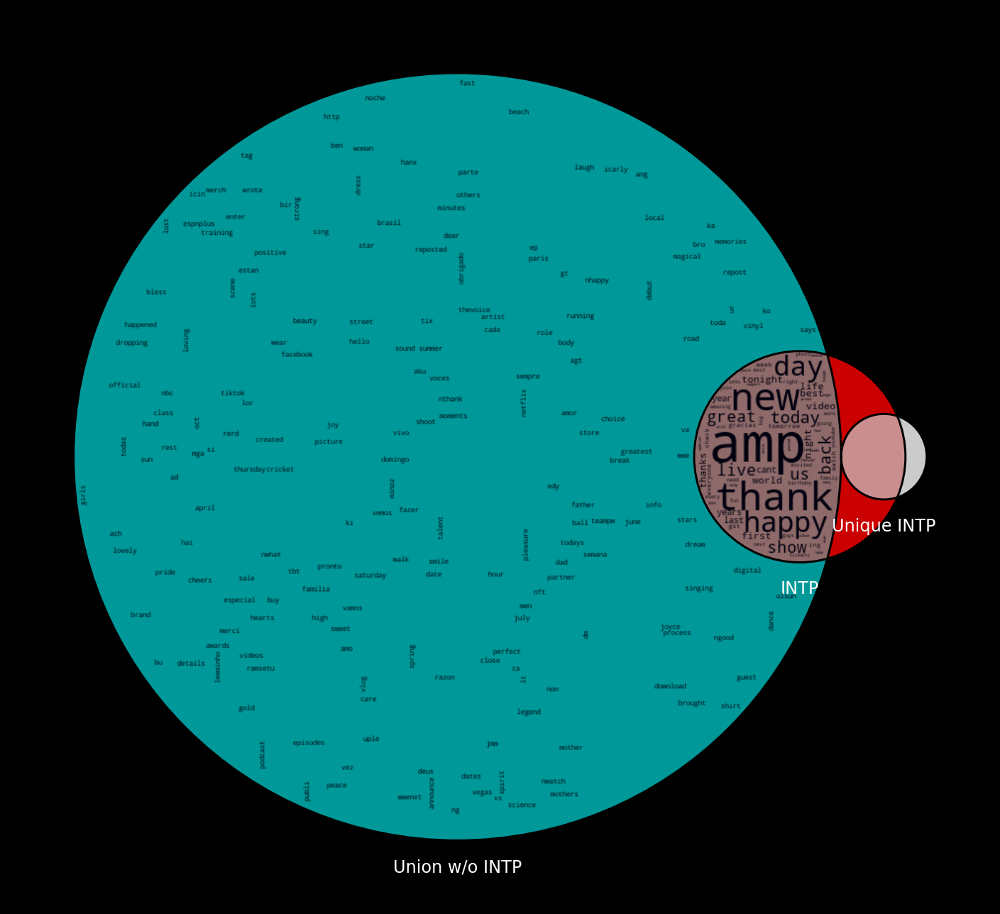

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        INTJ

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
2524 
intersection combined percent:
5.44%
number unique to 
337
 percent unique of aggregate union combined:
0.73%
intersection with rest length:
2187 
intersection with rest percent overlap with combined:
4.71%




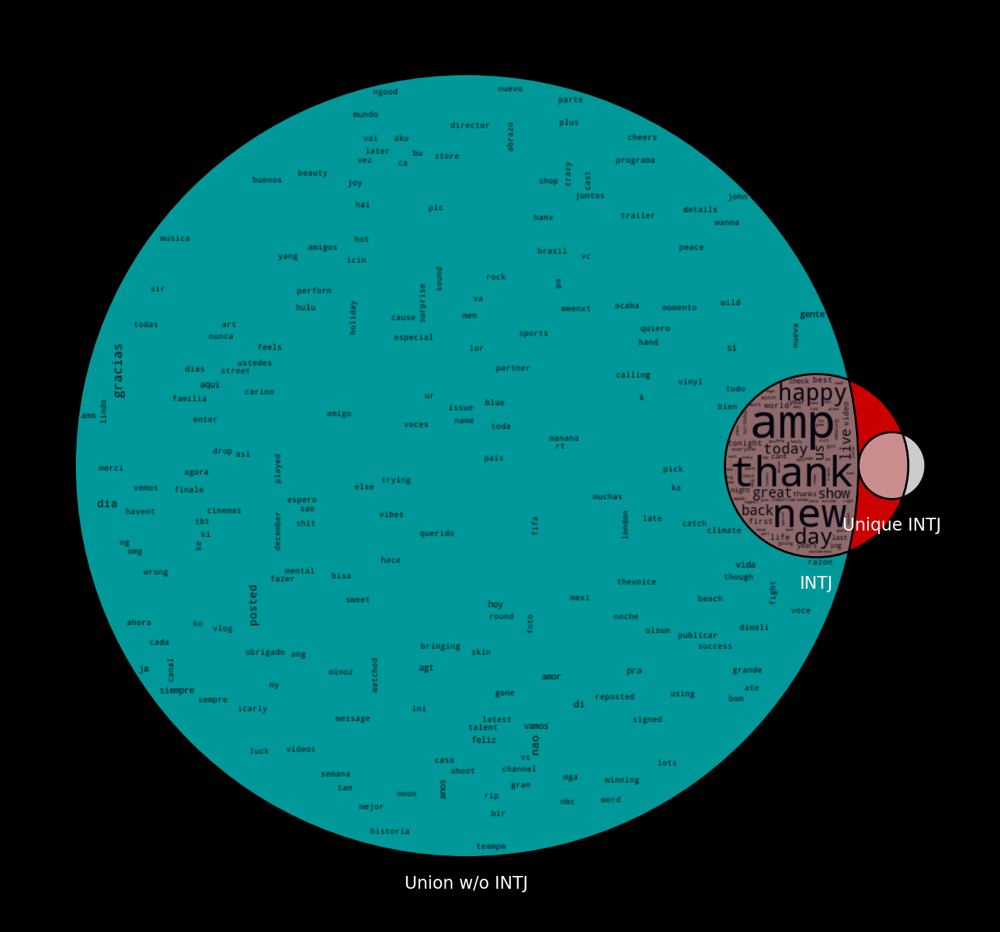

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        INFP

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
4660 
intersection combined percent:
10.04%
number unique to 
867
 percent unique of aggregate union combined:
1.87%
intersection with rest length:
3793 
intersection with rest percent overlap with combined:
8.17%




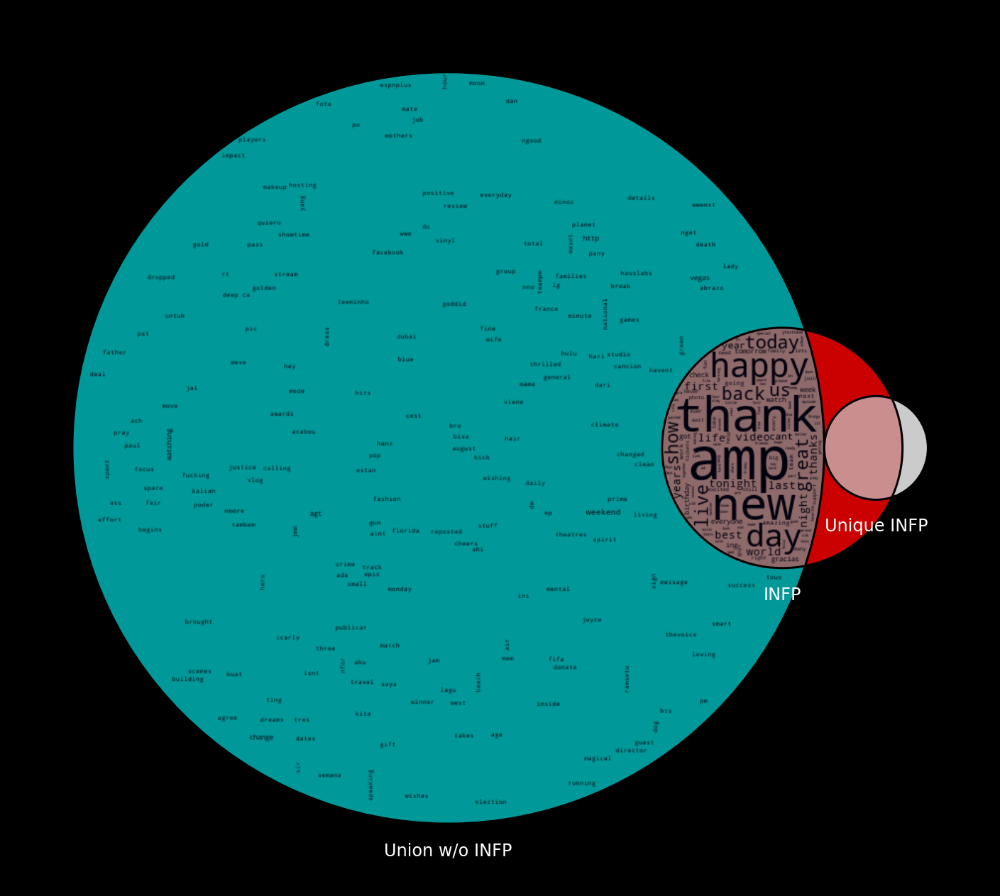

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        INFJ

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
5155 
intersection combined percent:
11.10%
number unique to 
887
 percent unique of aggregate union combined:
1.91%
intersection with rest length:
4268 
intersection with rest percent overlap with combined:
9.19%




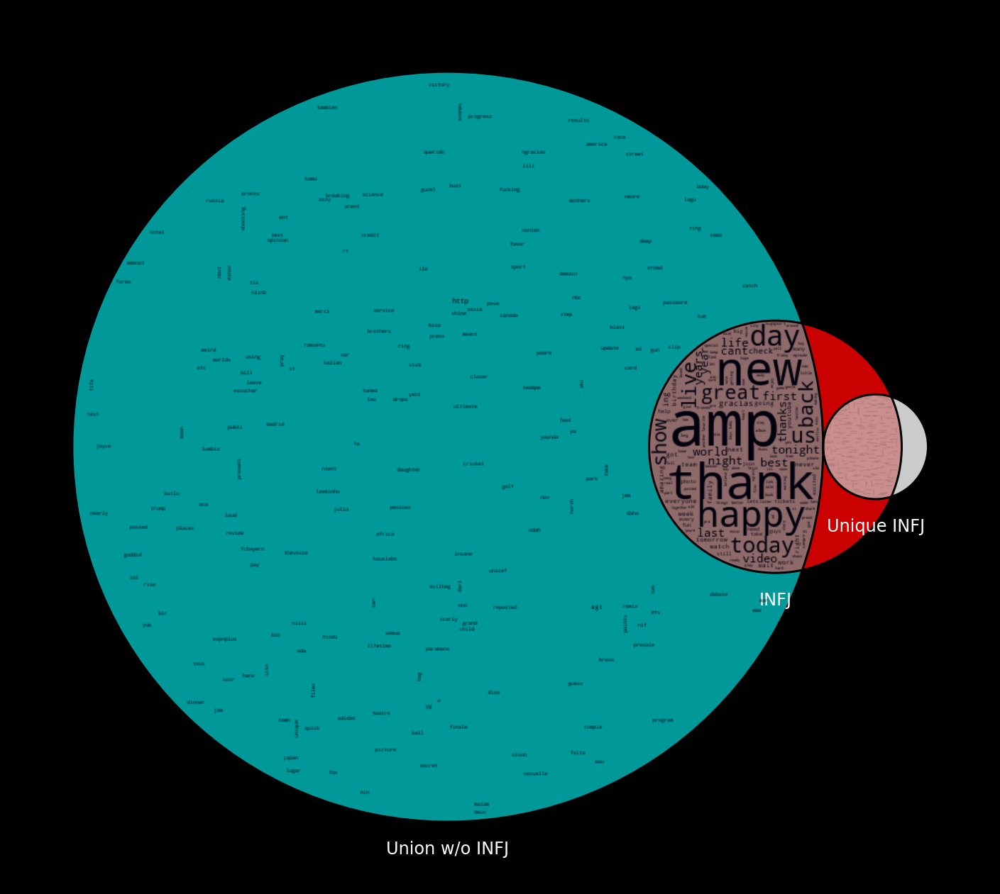

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ESTP

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
9115 
intersection combined percent:
19.63%
number unique to 
2200
 percent unique of aggregate union combined:
4.74%
intersection with rest length:
6915 
intersection with rest percent overlap with combined:
14.89%




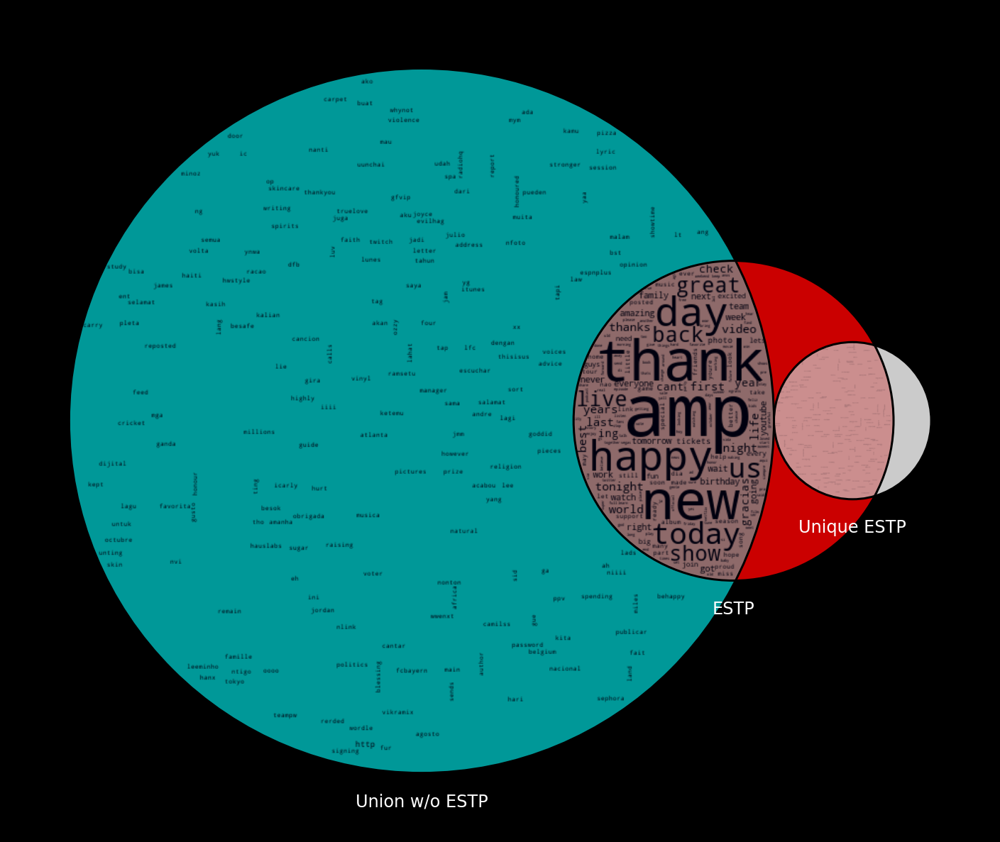

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ESTJ

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
5885 
intersection combined percent:
12.67%
number unique to 
1173
 percent unique of aggregate union combined:
2.53%
intersection with rest length:
4712 
intersection with rest percent overlap with combined:
10.15%




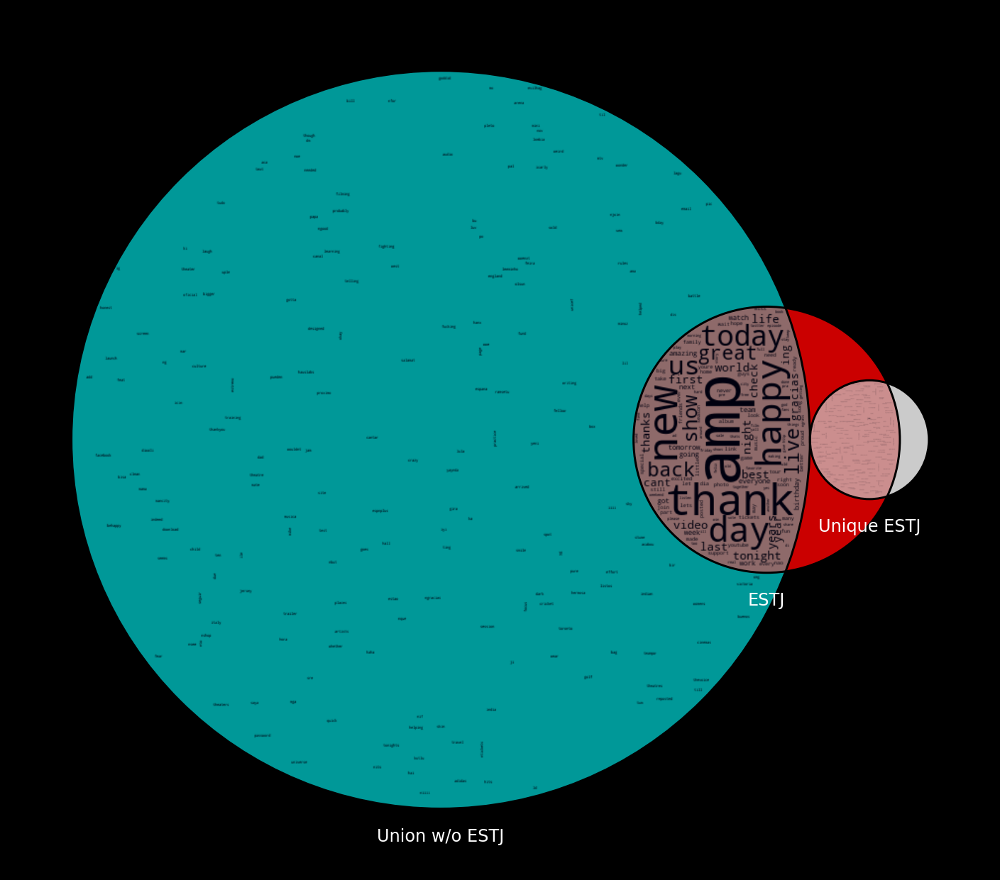

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ESFP

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
15034 
intersection combined percent:
32.38%
number unique to 
4717
 percent unique of aggregate union combined:
10.16%
intersection with rest length:
10317 
intersection with rest percent overlap with combined:
22.22%




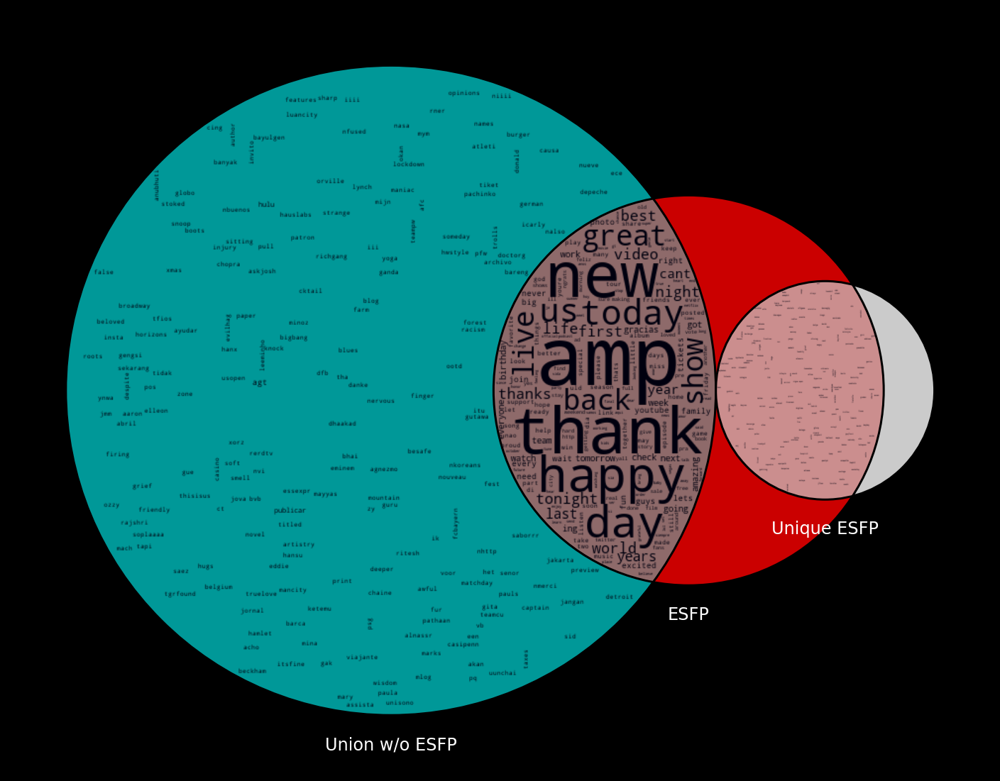

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ESFJ

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
12053 
intersection combined percent:
25.96%
number unique to 
3593
 percent unique of aggregate union combined:
7.74%
intersection with rest length:
8460 
intersection with rest percent overlap with combined:
18.22%




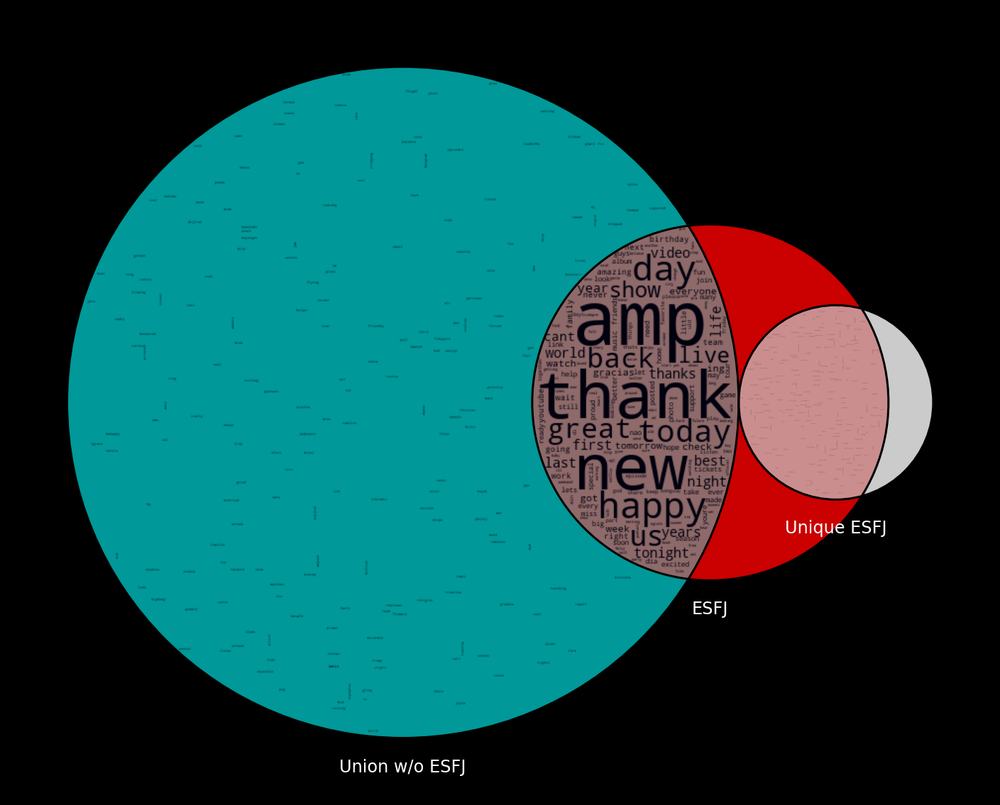

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ENTP

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
10700 
intersection combined percent:
23.05%
number unique to 
3010
 percent unique of aggregate union combined:
6.48%
intersection with rest length:
7690 
intersection with rest percent overlap with combined:
16.56%




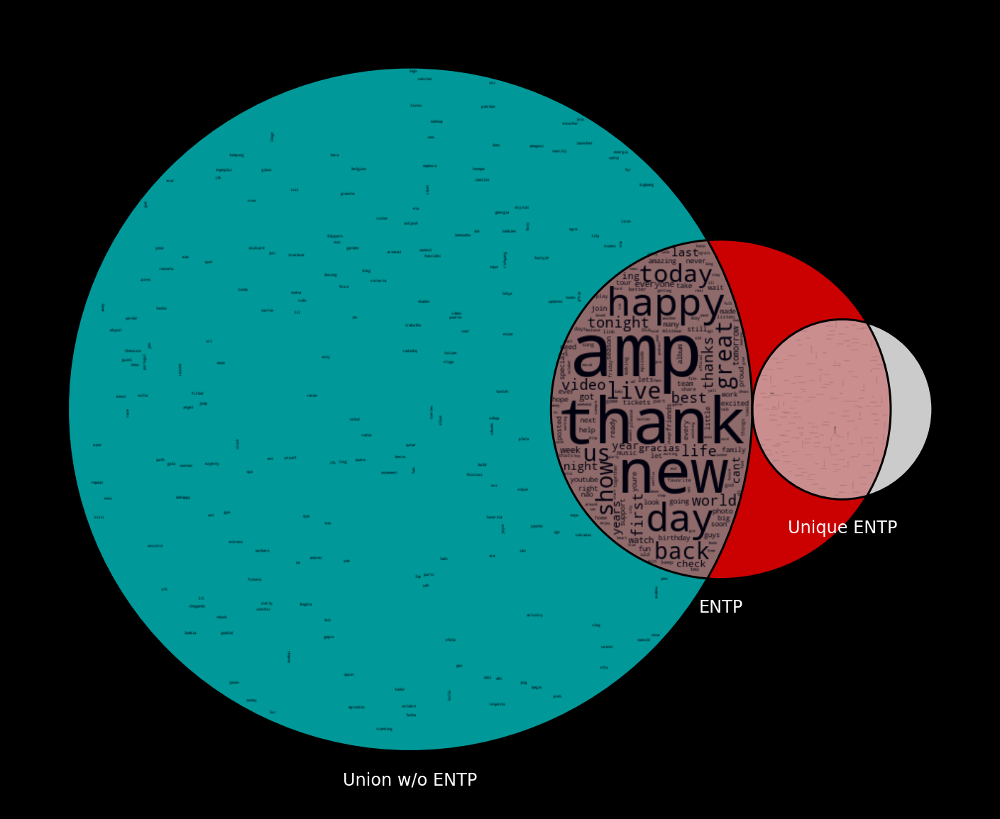

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ENTJ

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
4924 
intersection combined percent:
10.61%
number unique to 
855
 percent unique of aggregate union combined:
1.84%
intersection with rest length:
4069 
intersection with rest percent overlap with combined:
8.76%




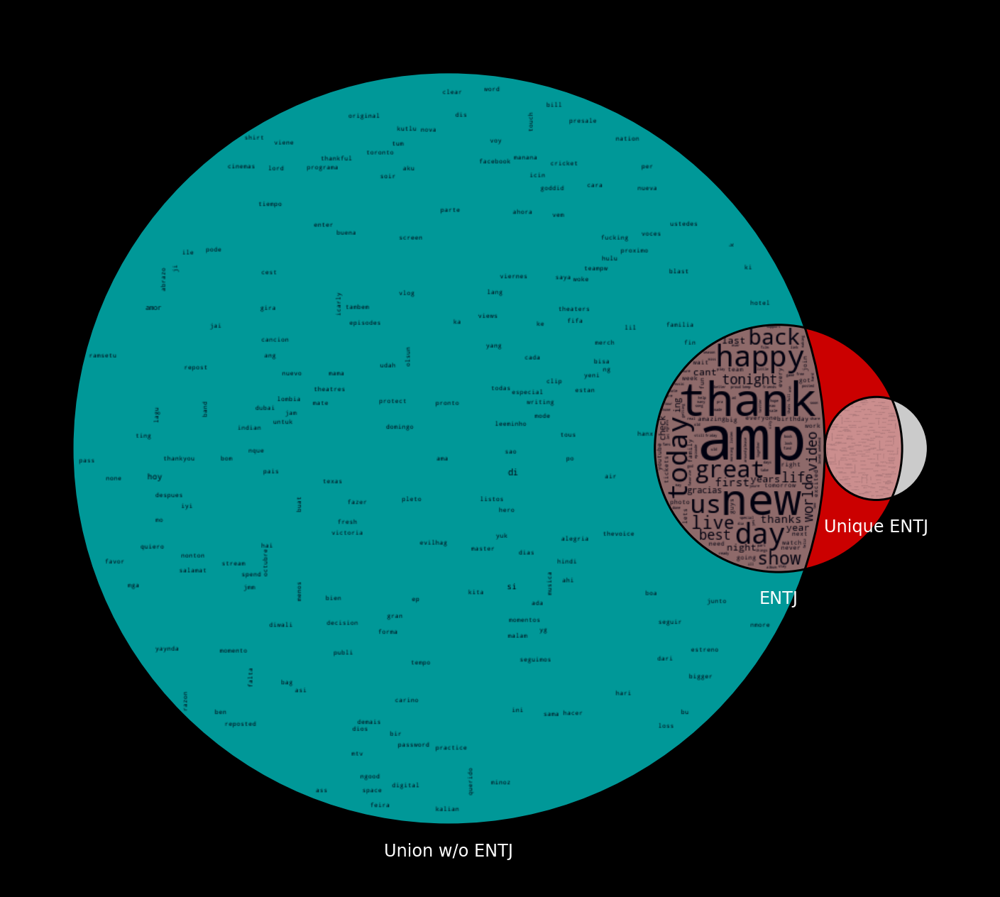

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ENFP

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
10943 
intersection combined percent:
23.57%
number unique to 
3047
 percent unique of aggregate union combined:
6.56%
intersection with rest length:
7896 
intersection with rest percent overlap with combined:
17.01%




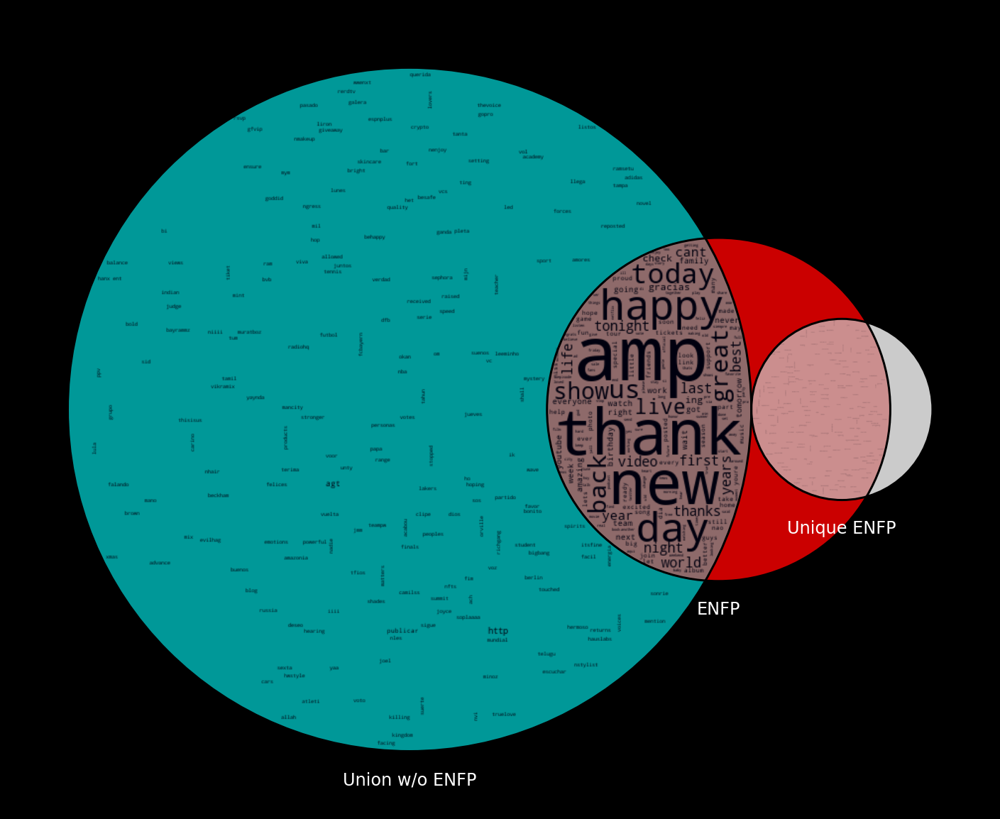

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ENFJ

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
7787 
intersection combined percent:
16.77%
number unique to 
1874
 percent unique of aggregate union combined:
4.04%
intersection with rest length:
5913 
intersection with rest percent overlap with combined:
12.74%




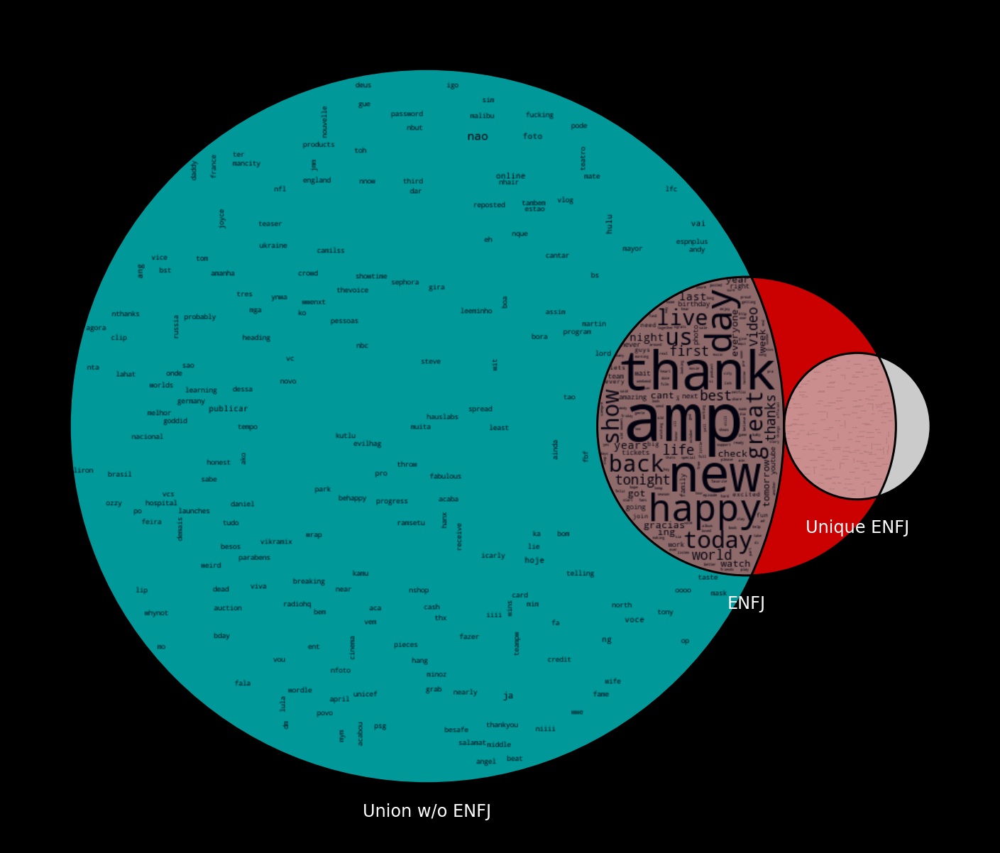

In [46]:

# wordcloud_kwargs=dict(max_font_size=10000, min_font_size=.5)

for i,k in enumerate(keys):
    keyscopy=deepcopy(keys)
    kthset=set(typessetdict.get(k))
    int=c&kthset
    intersectiondict.update({k:int,'intersection count':len(int)})
    kfreq=freqdict.get(k)
   
    keyscopy.pop(i)
    unionwithoutk=set()
    fig,ax=plt.subplots(figsize=(25,25))
    
    [unionwithoutk.update(typessetdict.get(cop))for cop in keyscopy]
    print(f'{"_":>2}'*45,f'\n\n{k:>60}\n\n',f'{"_":>2}'*45,f'\n\nintersection length:\n{len(int)}',f'\nintersection combined percent:\n{(len(int)/len(c))*100:.2f}%')

   

    print(f'number unique to \n{len(kthset-unionwithoutk)}\n',f'percent unique of aggregate union combined:\n{((len(kthset-unionwithoutk))/len(c))*100:.2f}%')
    restint=kthset&unionwithoutk
    print(f'intersection with rest length:\n{len(restint)}',f'\nintersection with rest percent overlap with combined:\n{(len(restint)/len(c))*100:.2f}%\n\n')
    
    venn3_wordcloud([kthset,unionwithoutk,kthset-unionwithoutk], set_colors=['red','c','w'],set_edgecolors=['0', '0','0'],ax=ax,set_labels=[f'{k}',f'Union w/o {k}',f'Unique {k}'],word_to_frequency=freqdict)#
    plt.show()
   




We have a total of 435 in the aggregate intersection
We remove that intersection to compare
 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ISTP

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
5707 
intersection combined percent:
12.29%
number unique to ISTP
1295
 percent unique of aggregate union combined:
2.79%
intersection with rest length:
4412 
intersection with rest percent overlap with combined:
9.50%




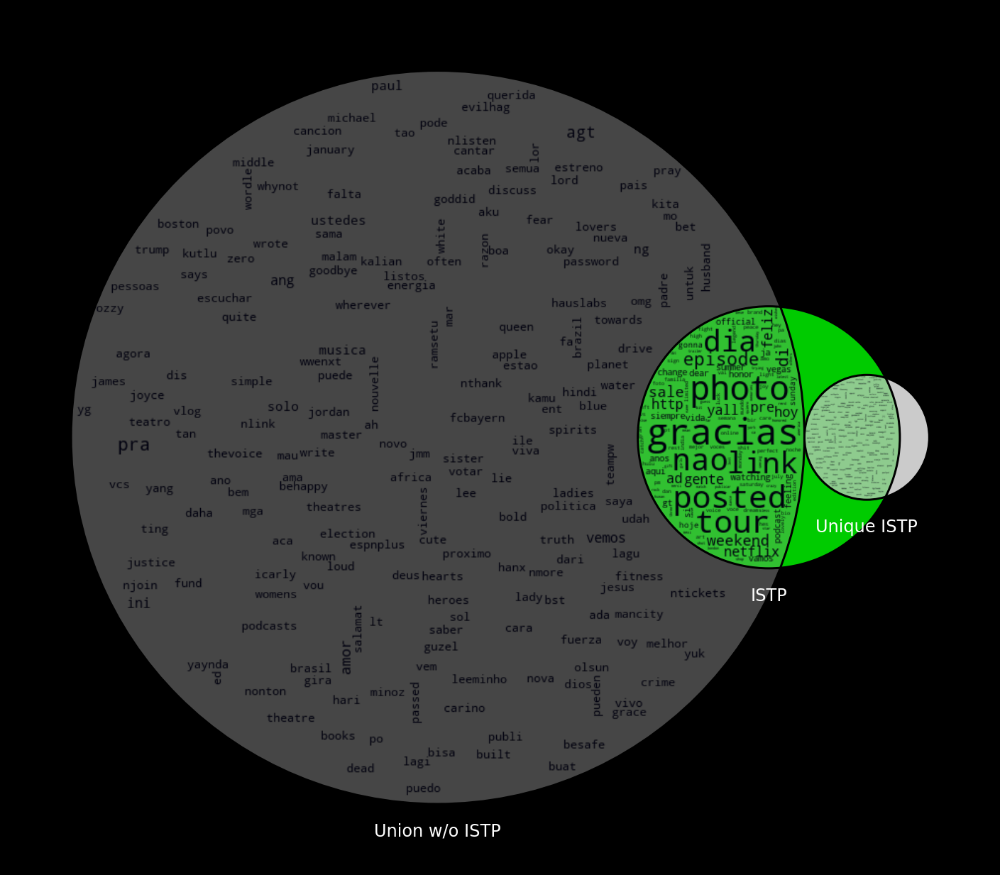

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ISTJ

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
2358 
intersection combined percent:
5.08%
number unique to ISTJ
536
 percent unique of aggregate union combined:
1.15%
intersection with rest length:
1822 
intersection with rest percent overlap with combined:
3.92%




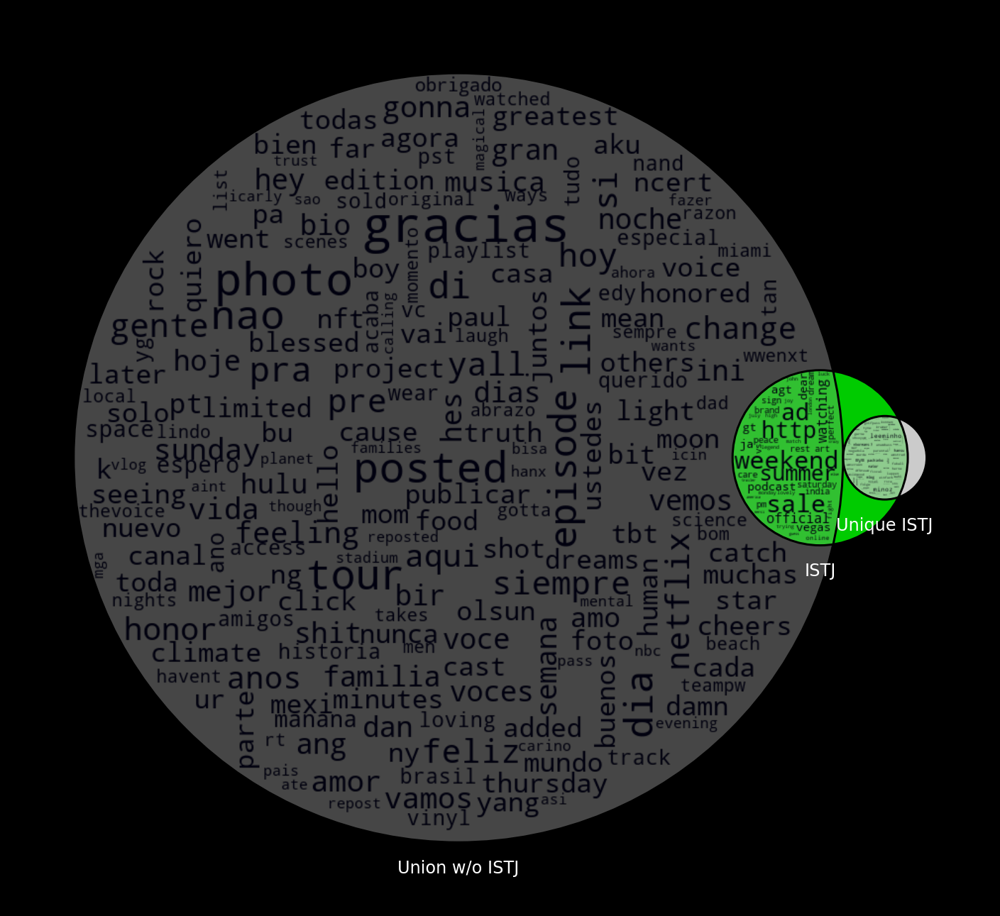

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ISFP

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
8162 
intersection combined percent:
17.58%
number unique to ISFP
2084
 percent unique of aggregate union combined:
4.49%
intersection with rest length:
6078 
intersection with rest percent overlap with combined:
13.09%




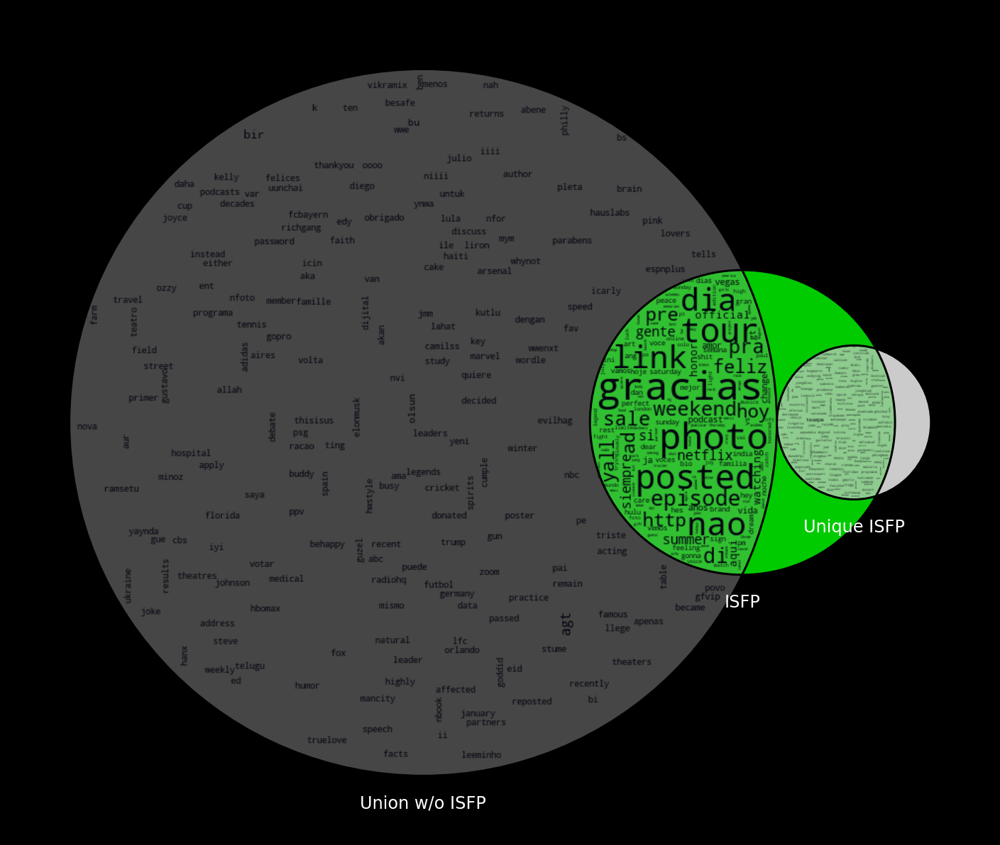

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ISFJ

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
6213 
intersection combined percent:
13.38%
number unique to ISFJ
1339
 percent unique of aggregate union combined:
2.88%
intersection with rest length:
4874 
intersection with rest percent overlap with combined:
10.50%




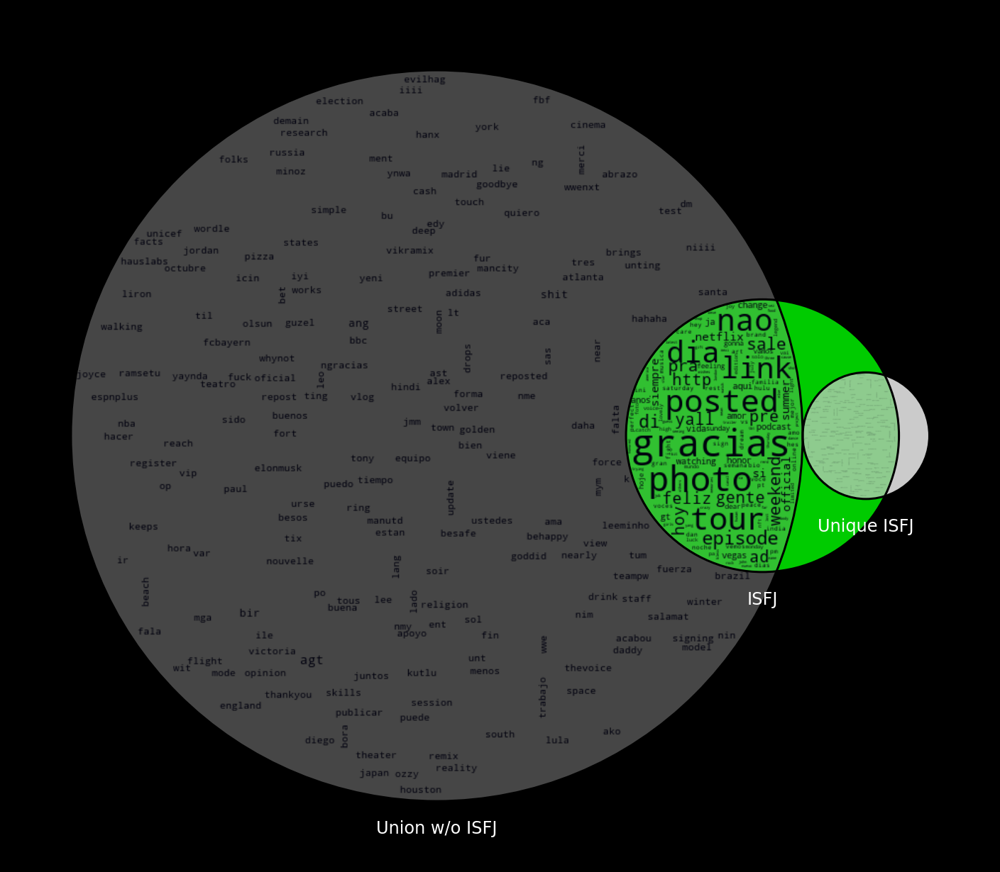

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        INTP

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
3041 
intersection combined percent:
6.55%
number unique to INTP
570
 percent unique of aggregate union combined:
1.23%
intersection with rest length:
2471 
intersection with rest percent overlap with combined:
5.32%




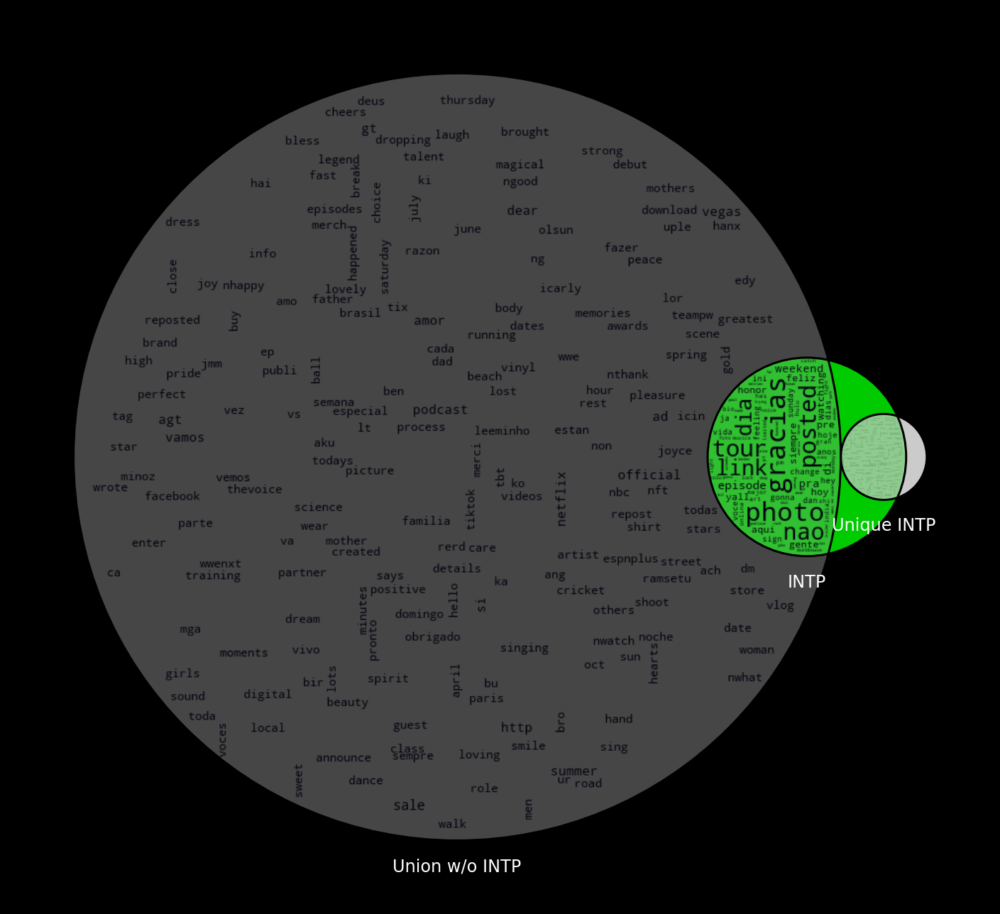

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        INTJ

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
2089 
intersection combined percent:
4.50%
number unique to INTJ
337
 percent unique of aggregate union combined:
0.73%
intersection with rest length:
1752 
intersection with rest percent overlap with combined:
3.77%




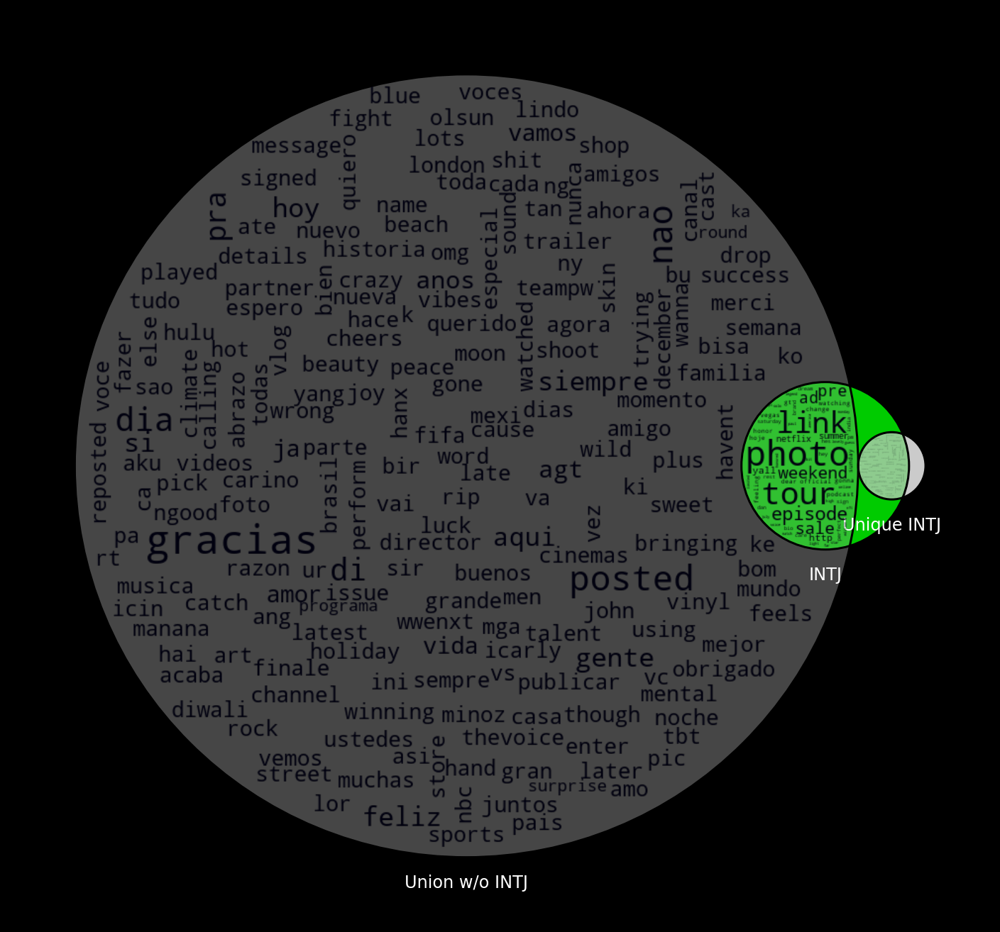

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        INFP

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
4225 
intersection combined percent:
9.10%
number unique to INFP
867
 percent unique of aggregate union combined:
1.87%
intersection with rest length:
3358 
intersection with rest percent overlap with combined:
7.23%




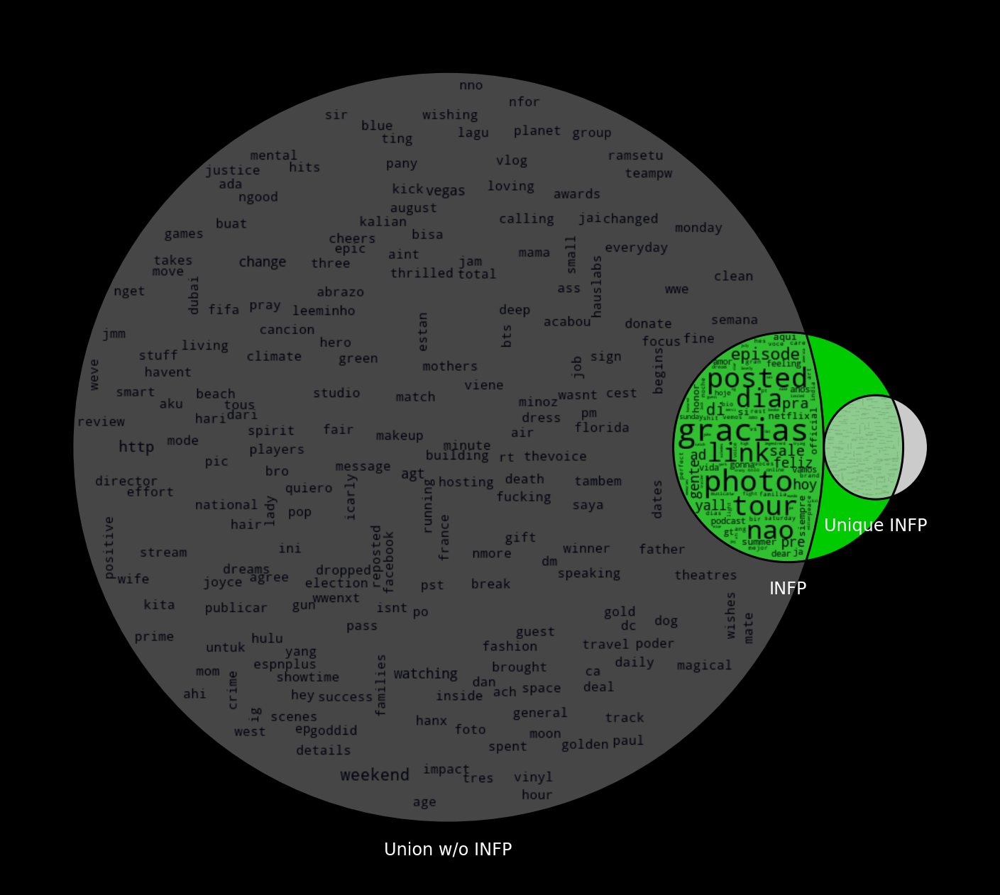

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        INFJ

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
4720 
intersection combined percent:
10.17%
number unique to INFJ
887
 percent unique of aggregate union combined:
1.91%
intersection with rest length:
3833 
intersection with rest percent overlap with combined:
8.26%




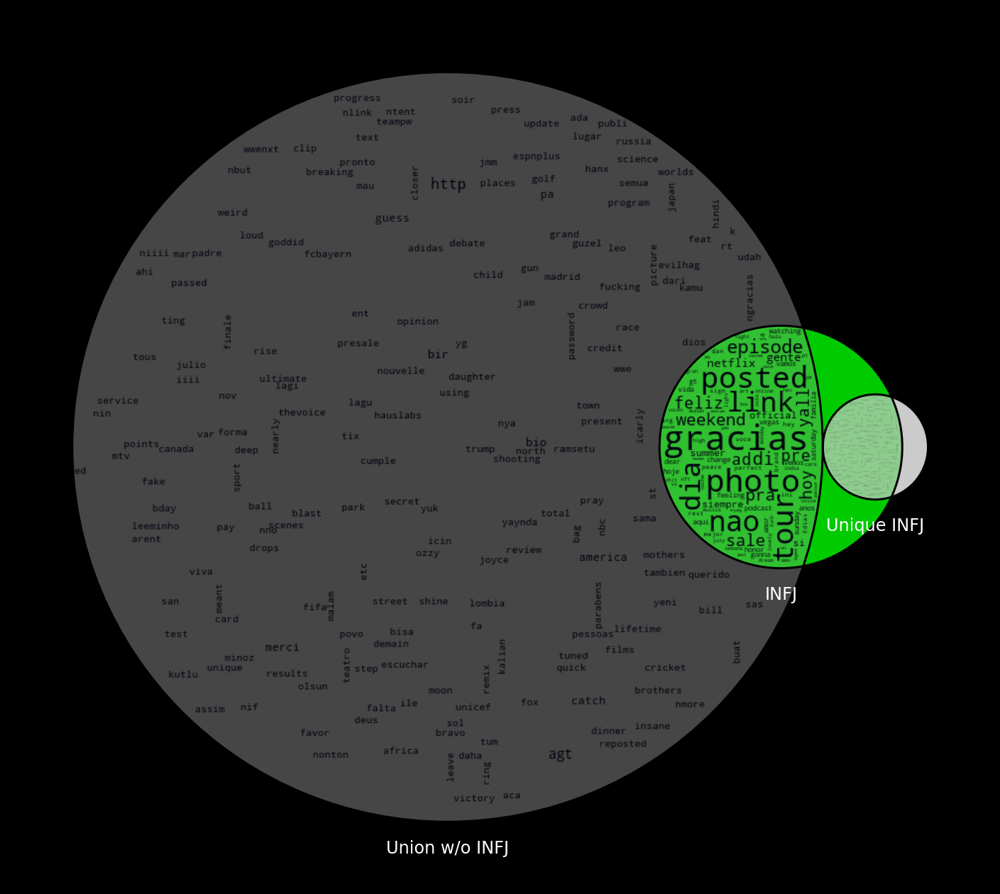

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ESTP

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
8680 
intersection combined percent:
18.69%
number unique to ESTP
2200
 percent unique of aggregate union combined:
4.74%
intersection with rest length:
6480 
intersection with rest percent overlap with combined:
13.96%




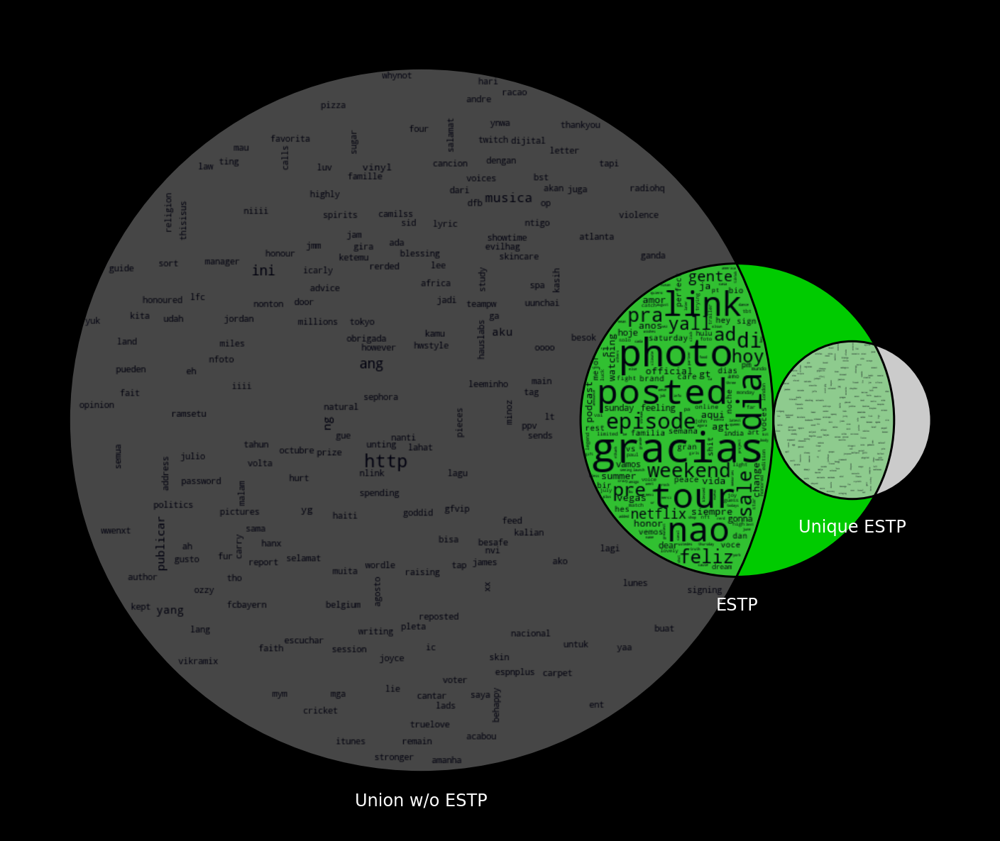

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ESTJ

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
5450 
intersection combined percent:
11.74%
number unique to ESTJ
1173
 percent unique of aggregate union combined:
2.53%
intersection with rest length:
4277 
intersection with rest percent overlap with combined:
9.21%




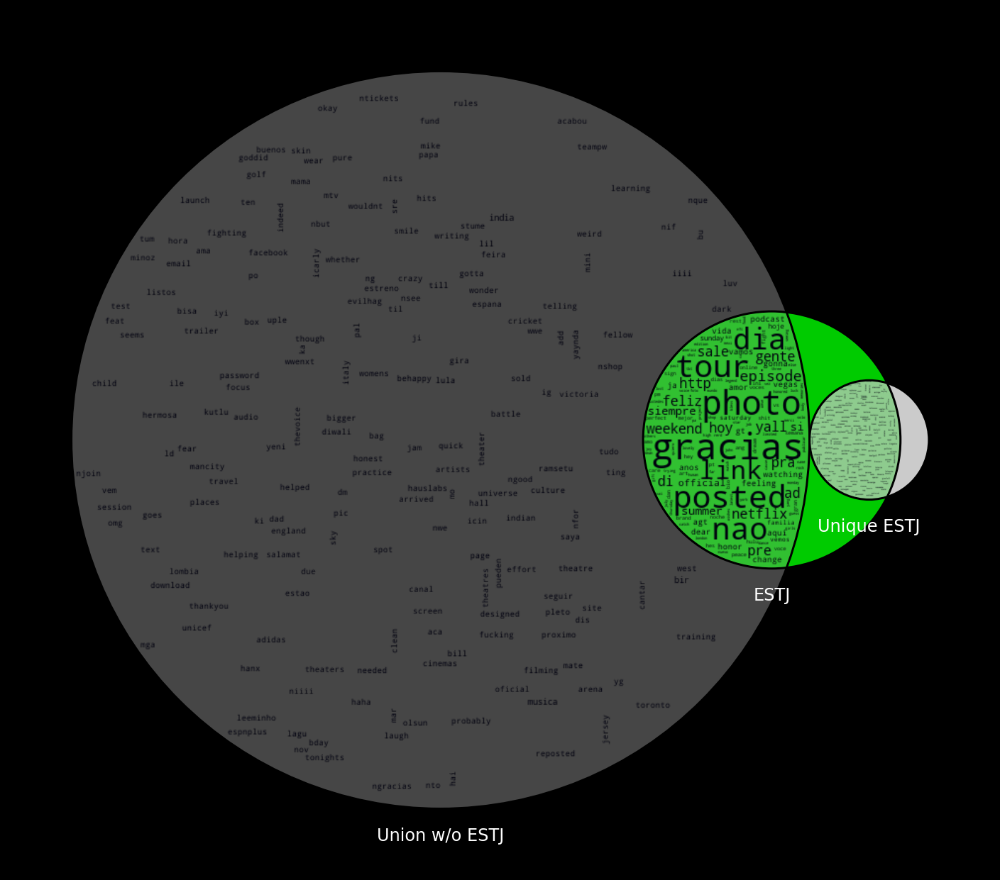

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ESFP

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
14599 
intersection combined percent:
31.44%
number unique to ESFP
4717
 percent unique of aggregate union combined:
10.16%
intersection with rest length:
9882 
intersection with rest percent overlap with combined:
21.28%




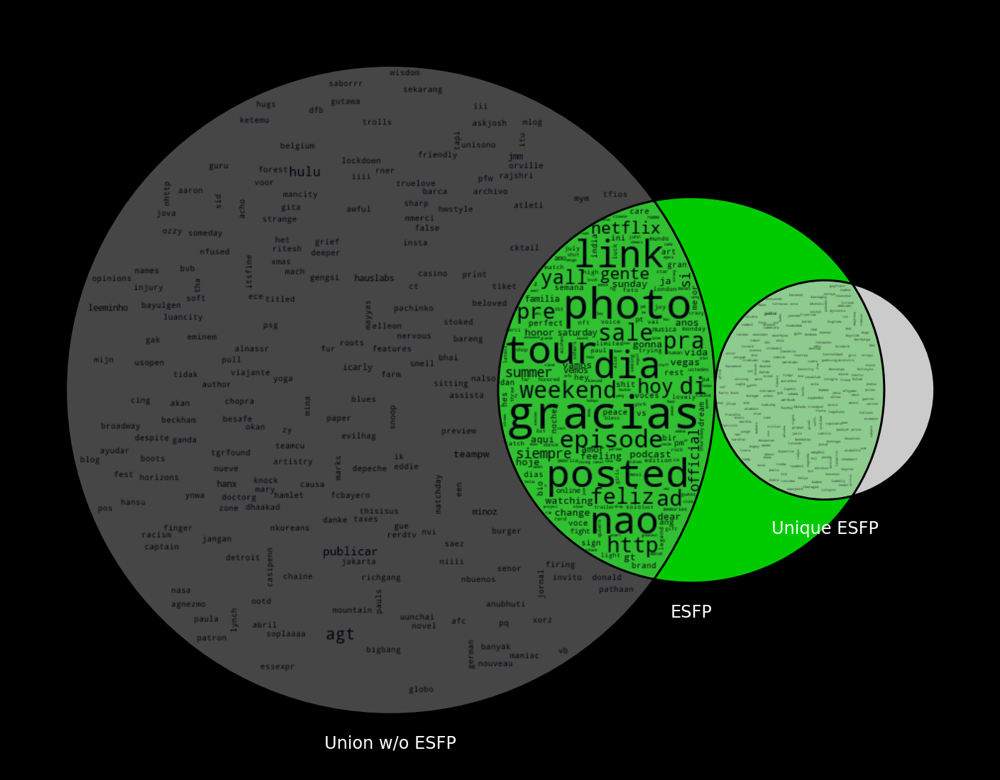

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ESFJ

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
11618 
intersection combined percent:
25.02%
number unique to ESFJ
3593
 percent unique of aggregate union combined:
7.74%
intersection with rest length:
8025 
intersection with rest percent overlap with combined:
17.28%




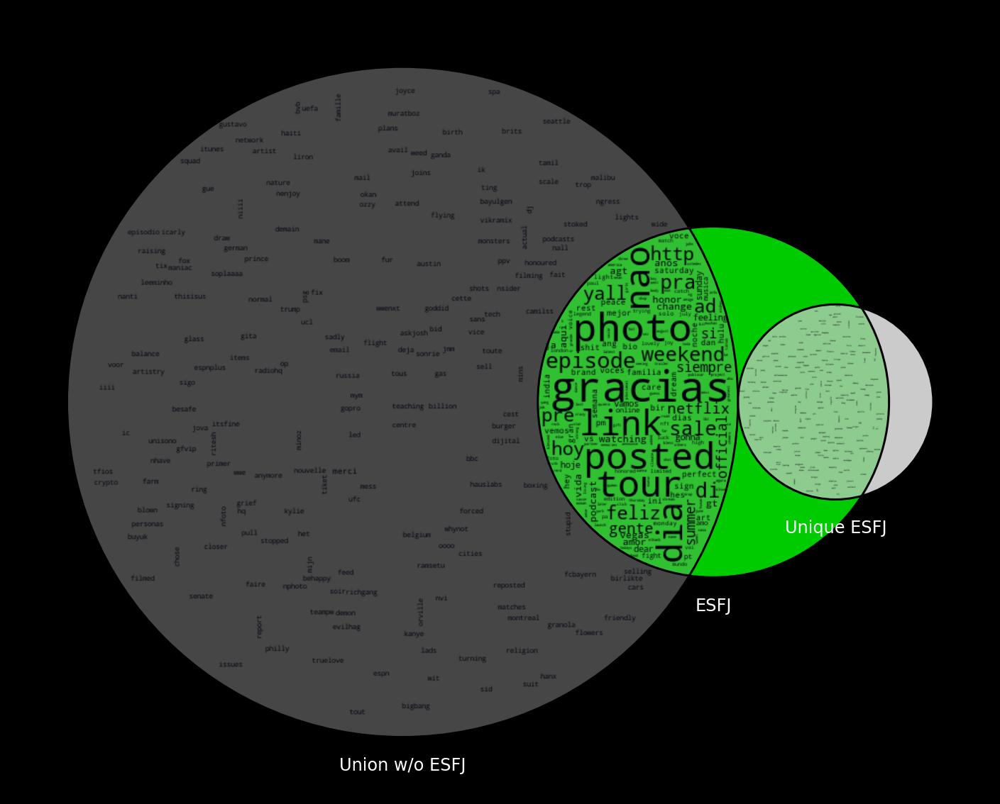

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ENTP

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
10265 
intersection combined percent:
22.11%
number unique to ENTP
3010
 percent unique of aggregate union combined:
6.48%
intersection with rest length:
7255 
intersection with rest percent overlap with combined:
15.63%




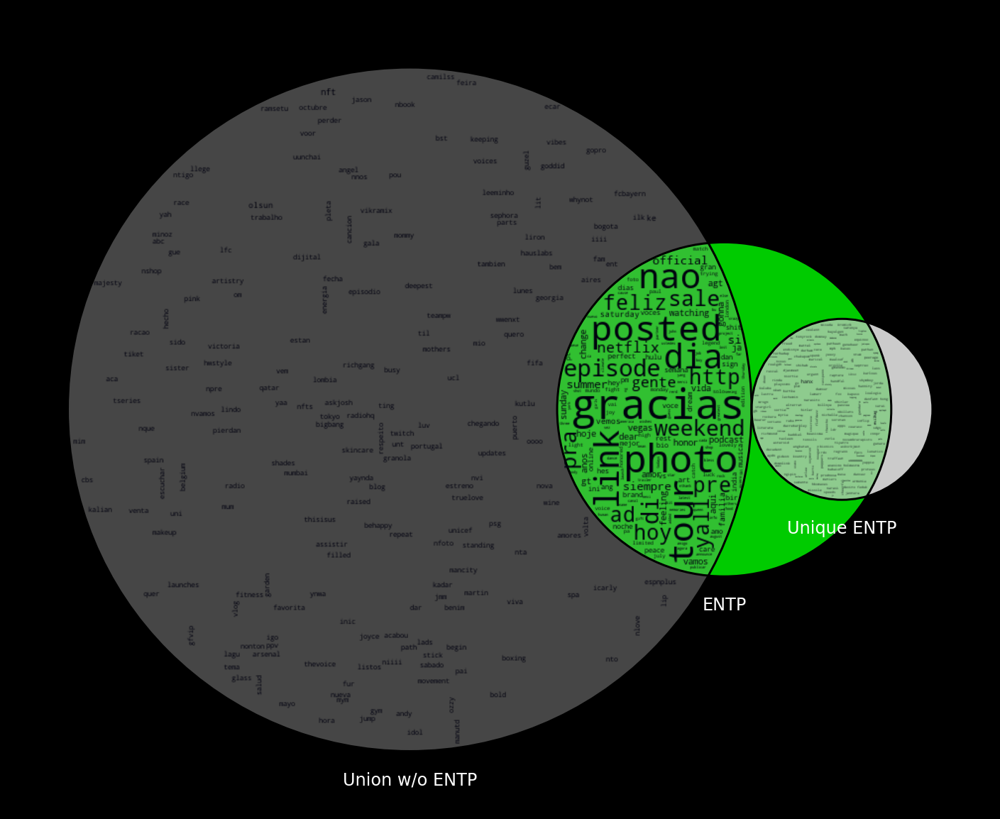

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ENTJ

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
4489 
intersection combined percent:
9.67%
number unique to ENTJ
855
 percent unique of aggregate union combined:
1.84%
intersection with rest length:
3634 
intersection with rest percent overlap with combined:
7.83%




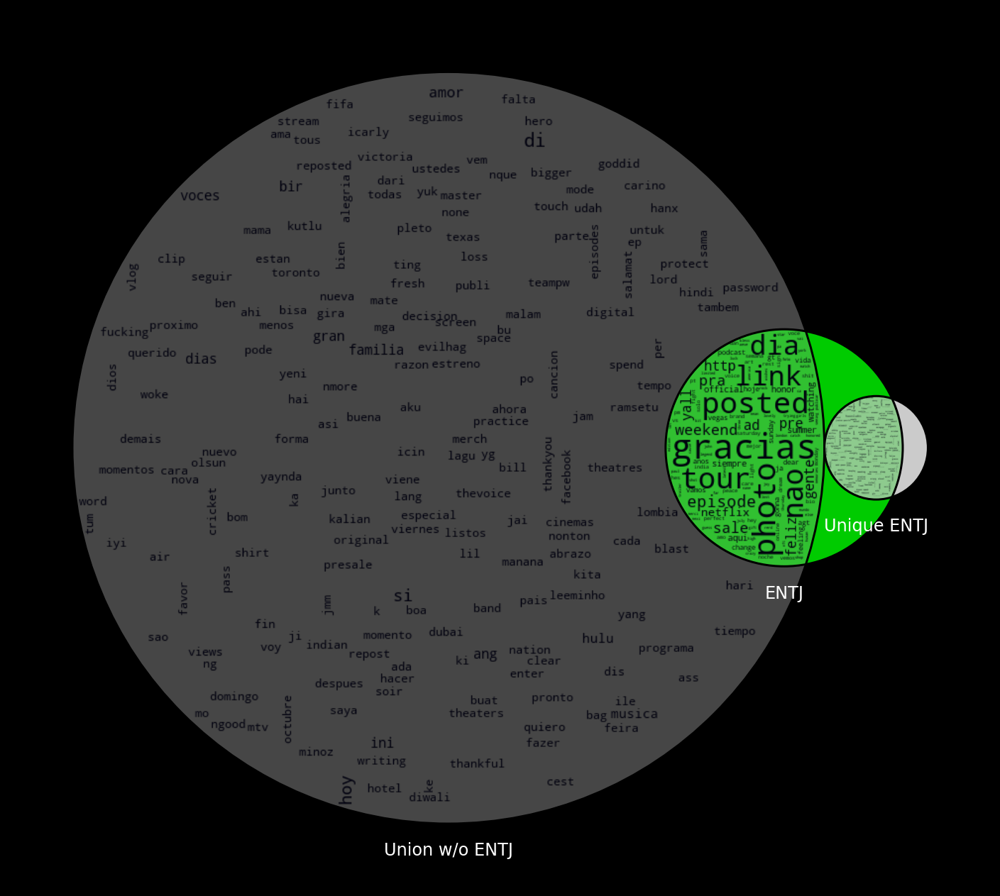

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ENFP

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
10508 
intersection combined percent:
22.63%
number unique to ENFP
3047
 percent unique of aggregate union combined:
6.56%
intersection with rest length:
7461 
intersection with rest percent overlap with combined:
16.07%




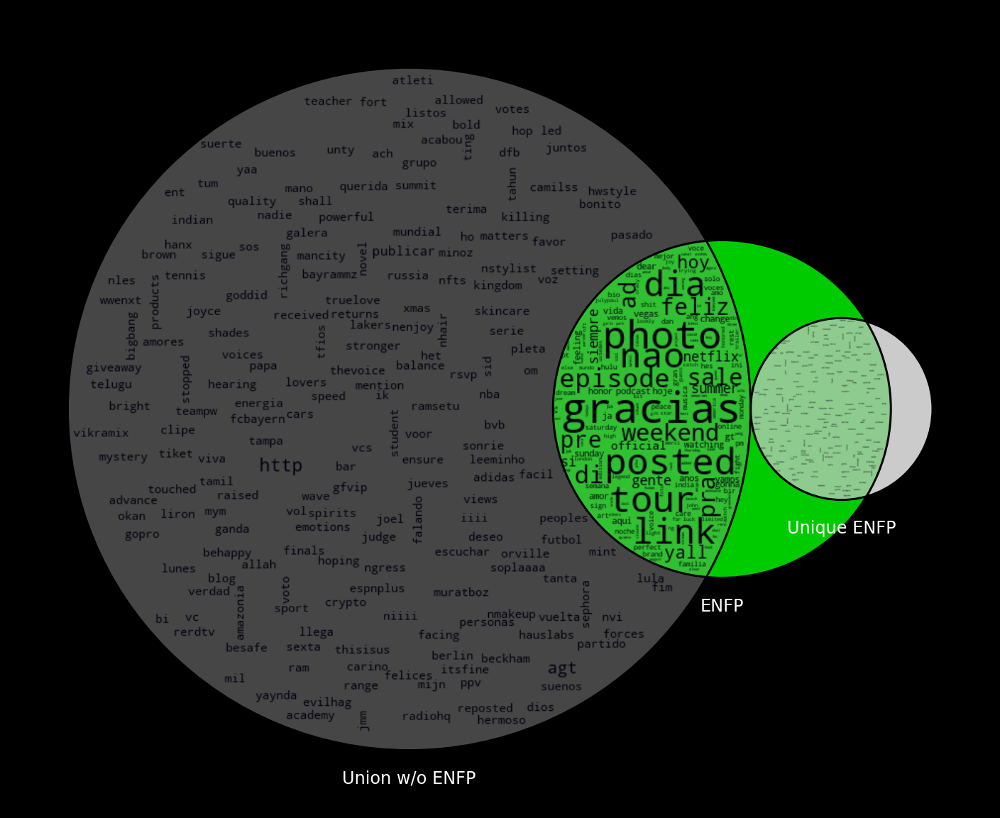

 _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

                                                        ENFJ

  _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ _ 

intersection length:
7352 
intersection combined percent:
15.83%
number unique to ENFJ
1874
 percent unique of aggregate union combined:
4.04%
intersection with rest length:
5478 
intersection with rest percent overlap with combined:
11.80%




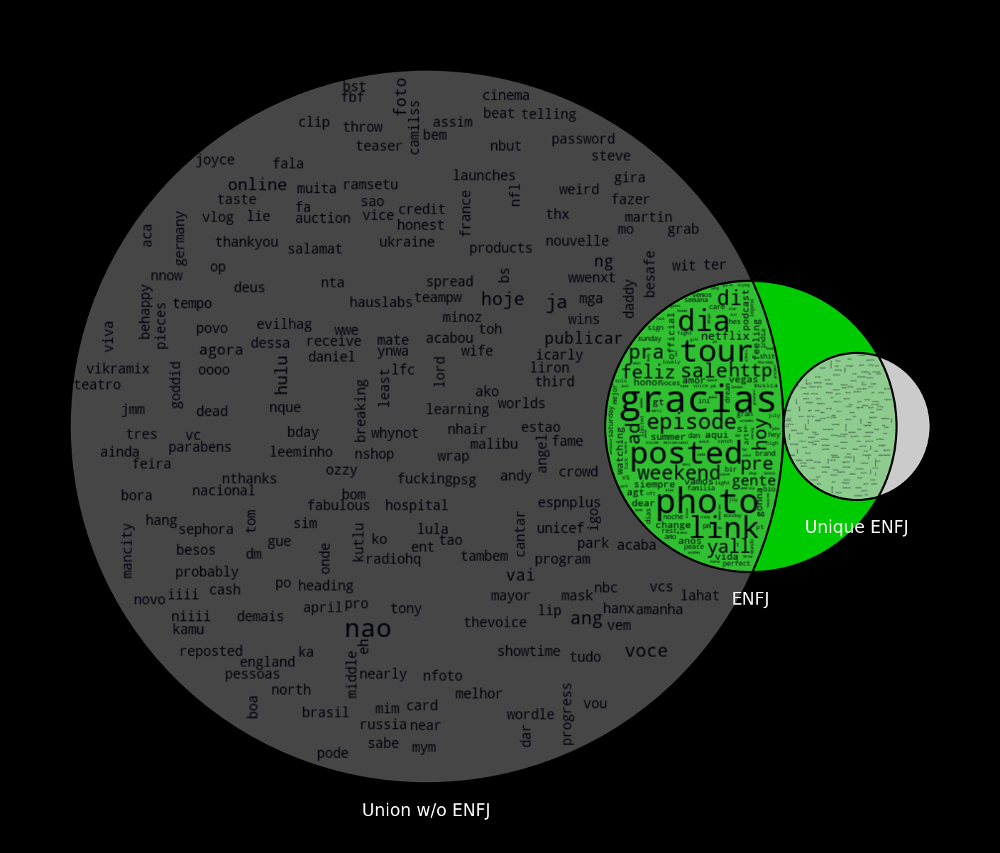

In [36]:
bigint=deepcopy(c)
[bigint.intersection_update(typessetdict.get(key))for key in keys]
print(f'We have a total of {len(bigint)} in the aggregate intersection\nWe remove that intersection to compare')
for i,k in enumerate(keys):
    keyscopy=deepcopy(keys)
    kthset=set(typessetdict.get(k))
    kthset=kthset-bigint
    int=(c&kthset)-bigint
    intersectiondict.update({k:int,'intersection count':len(int)})
    kfreq=freqdict.get(k)
   
    keyscopy.pop(i)
    unionwithoutk=set()
    fig,ax=plt.subplots(figsize=(25,25))
    
    [unionwithoutk.update(typessetdict.get(cop))for cop in keyscopy]
    unionwithoutk=unionwithoutk-bigint
    print(f'{"_":>2}'*45,f'\n\n{k:>60}\n\n',f'{"_":>2}'*45,f'\n\nintersection length:\n{len(int)}',f'\nintersection combined percent:\n{(len(int)/len(c))*100:.2f}%')

    unique=(kthset-unionwithoutk)-bigint

    print(f'number unique to {k}\n{len(unique)}\n',f'percent unique of aggregate union combined:\n{(len(unique)/len(c))*100:.2f}%')
    restint=(kthset&unionwithoutk)-bigint
    print(f'intersection with rest length:\n{len(restint)}',f'\nintersection with rest percent overlap with combined:\n{(len(restint)/len(c))*100:.2f}%\n\n')
    
    venn3_wordcloud([kthset,unionwithoutk,kthset-unionwithoutk], set_colors=['lime','.35','w'],set_edgecolors=['0', '0','0'],ax=ax,set_labels=[f'{k}',f'Union w/o {k}',f'Unique {k}'],word_to_frequency=freqdict)#
    plt.show()
   




In [37]:


# from itertools import product 
  
# # Get all permutations of length 2 
# # and length 2 
# x=["".join(seq) for seq in product("01", repeat=4)]
# for i in x:
#     print(i[0])






In [38]:
sumforavg=dataframe[['type','name']].groupby(['type']).nunique().sum()
tochart=(dataframe[['type','name']].groupby(['type']).nunique()/sumforavg)*100

tochart=tochart.reset_index()
tochart['percent']=tochart['name']

tochart.drop(columns='name',inplace=True)




tochart.index=tochart.type
tochart.drop(columns='type',inplace=True)
tochart=tochart.sort_values(by='percent',ascending=False)



genpoppercent=['13.8% 12.3% 11.6% 8.8% 8.7% 8.5% 8.1% 5.4% 4.4% 4.3% 3.3% 3.2% 2.5% 2.1% 1.8% 1.5%']
genpoppercent=str(genpoppercent).replace('%','').split()
genpoppercent=[float(i.replace('[','').replace(']','').replace('"','').strip("'")) for i in genpoppercent]


types=['ISFJ ESFI ISTJ ISFP ESTI ESFP ENFP ISTP INFP ESTP INTP ENTP ENFJ INTJ ENTI INFT']
types=str(types).split()


types=[(i.replace('[','').replace(']','').replace('"','').strip("'")) for i in types]

pop=pd.DataFrame(index=types,data={'pop percentage':genpoppercent})

tochart=pd.concat([tochart,pop],axis=1,join='inner')
tochart.rename(columns={'percent':'found percent'},inplace=True)
cols=['pop percentage','found percent']
tochart=tochart[cols]
tochart.sort_values(by='pop percentage',ascending=False,inplace=True)


In [39]:
# 
styleddf=tochart.T.style.background_gradient(cmap='Blues',axis=1).format(lambda x : f'{x:.1f}%')



In [40]:
quad1=[0,0,0,0]
quad2=[0,0,0,0]
quad3=[0,.25,.35,.25]
quad4=[.35,.25,.35,.25]

explode = []
explode.extend(quad1)
explode.extend(quad2)
explode.extend(quad3)
explode.extend(quad4)





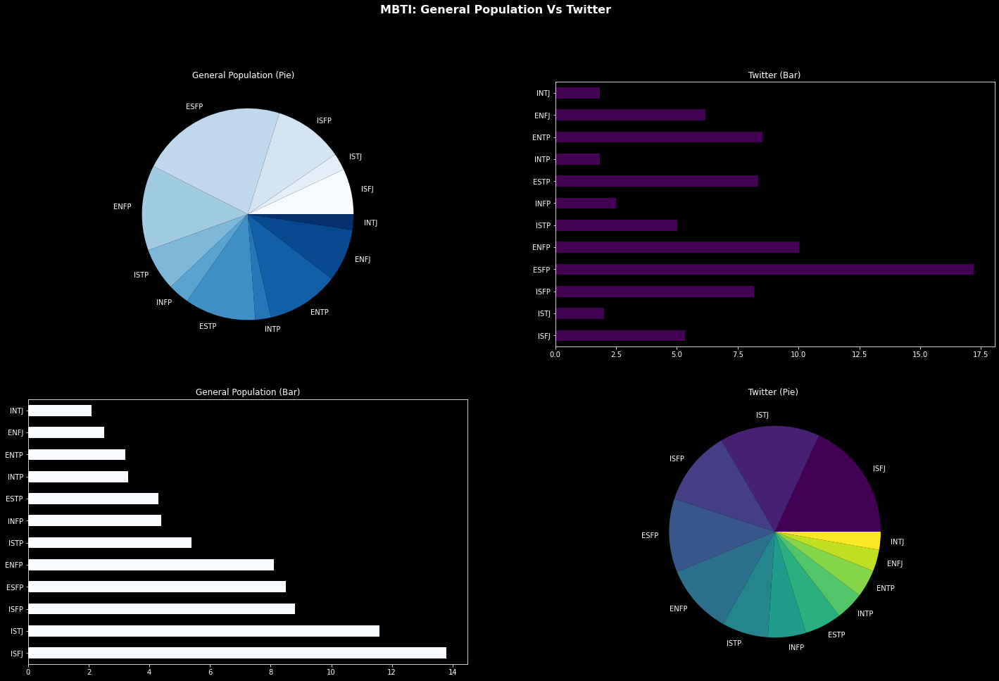

'Summary'

,ISFJ,ISTJ,ISFP,ESFP,ENFP,ISTP,INFP,ESTP,INTP,ENTP,ENFJ,INTJ
pop percentage,13.8%,11.6%,8.8%,8.5%,8.1%,5.4%,4.4%,4.3%,3.3%,3.2%,2.5%,2.1%
found percent,5.3%,2.0%,8.2%,17.2%,10.0%,5.0%,2.5%,8.3%,1.8%,8.5%,6.2%,1.8%


In [41]:
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec


def format_axes(fig):
    for i, ax in enumerate(fig.axes):
        ax.text(0.5, 0.5, "ax%d" % (i+1), va="center", ha="center")
        ax.tick_params(labelbottom=False, labelleft=False)
m=1.23
fig = plt.figure(constrained_layout=False,figsize=(m*20,m*12.361))

gs = GridSpec(2, 2, figure=fig)

# identical to ax1 = plt.subplot(gs.new_subplotspec((0, 0), colspan=3))



plt.suptitle('MBTI: General Population Vs Twitter',fontsize=16,weight='demibold')





ax1 = fig.add_subplot(gs[0, 0])
kwargs1={'title':'General Population (Pie)   ','ax':ax1,'legend':False,'ylabel':'',   'cmap':'Blues'}

tochart.plot.pie(y='found percent',**kwargs1)



ax2 = fig.add_subplot(gs[1, 1])

kwargs2={'title':'  Twitter (Pie)   ','ax':ax2,'legend':False,'ylabel':'',   'cmap':'viridis'}
tochart.plot.pie(y='pop percentage',**kwargs2)


ax3 = fig.add_subplot(gs[0,1])
kwargs3={'ax':ax3,'legend':False,'title':'Twitter (Bar)',   'cmap':'viridis'}

tochart.plot.barh(y='found percent',**kwargs3)




ax4 = fig.add_subplot(gs[1, 0])
kwargs4={'ax':ax4,'legend':False,'title':'General Population (Bar)',   'cmap':'Blues'}
tochart.plot.barh(y='pop percentage',**kwargs4)

plt.show()




fig.suptitle("GridSpec")
format_axes(fig)

plt.show()




display('Summary',styleddf)

# Everything Below was an attempt at Multithreading and Paralellism
* ## This can be ignored

In [42]:






# Below are two ways of scraping using CLI commands.
# Comment or uncomment as you need. If you currently run the script as is it will scrape both queries
# then output two different csv files.

# Query by username
# Setting variables to be used in format string command below
# def parralledindexer():
#  #tweet count number is the last n tweets
#  # #read in top 1,000 celebs
#     url='https://gist.githubusercontent.com/mbejda/9c3353780270e7298763/raw/1bfc4810db4240d85947e6aef85fcae71f475493/Top-1000-Celebrity-Twitter-Accounts.csv'
#     tweet_count=100

#     celebs=pd.read_csv(url).to_dict()
#     count=-1*tweet_count
#     celeblen=len(list(celebs.get('twitter').keys()))
#     numindex=range(0,tweet_count*celeblen)

#     c_with_slice={}
#     for c in range(0,celeblen,1):  
#             count=count+tweet_count
#             maxnum=count+tweet_count     
#             cur=numindex[count:maxnum]
#             c_with_slice.update({c:cur})
           

    # mod10={}
    # mod9={}
    # mod8={}
    # mod7={}
    # mod6={}
    # mod5={}
    # mod4={}
    # mod3={}
    # mod2={}
    # keylist=list(c_with_slice.keys())
    # for i in keylist:
    #     if i%10==0:  
    #         mod10.update({i:c_with_slice.get(i)})
    #     elif i%9==0:      
    #         mod9.update({i:c_with_slice.get(i)})
    #     elif i%8==0:       
    #         mod8.update({i:c_with_slice.get(i)})
    #     elif i%7==0:      
    #         mod7.update({i:c_with_slice.get(i)})
    #     elif i%6==0:      
    #         mod6.update({i:c_with_slice.get(i)})
    #     elif i%5==0:      
    #         mod5.update({i:c_with_slice.get(i)})
    #     elif i%4==0:       
    #         mod4.update({i:c_with_slice.get(i)})
    #     elif i%3==0:      
    #         mod3.update({i:c_with_slice.get(i)})
    #     elif i%2==0:     
    #         mod2.update({i:c_with_slice.get(i)})
#     moddicts=c_with_slice
        

#     # moddicts={**mod10,**mod9,
#     # **mod8,
#     # **mod7,
#     # **mod6,
#     # **mod5,
#     # **mod4,
#     # **mod3,
#     # **mod2}
#     return moddicts,celebs

# moddicts,celebs=parralledindexer()

# ###Think of schem to split then pu



In [43]:


# def actualparrelel():
#     '''
    
#     slow as shit for input output this is for data processing on the comp
    
    
#     '''
#     moddicts,celebs=parralledindexer()
#     values=[]
    
    
#     # protect the entry point
#     if __name__ == '__main__':
#         # create and configure the process pool
#         with Pool(10) as pool:
#             arglist=[]   
#             for m in moddicts:
#                 arglist.append((m,celebs)) 


           
#             results_async=pool.starmap_async(partitionableTwitterscraper,arglist)
#             # get the return values
#             try:
#                 for value in results_async.get():
#                     values.append(value)

#             except Exception as e:
#                 print(f'Failed with: {e}')
#     return values






# def actualthreading():
#     moddicts,celebs=parralledindexer()
#     values=[]
    
    
#     # protect the entry point
#     if __name__ == '__main__':
#         # create and configure the process pool
  
#             arglist=[]   
#             for m,v in moddicts.items():
#                 arglist.append({m:v})
#             # print(arglist) #this is fine    

#     # We can use a with statement to ensure threads are cleaned up promptly

#     threads = min(50, len(moddicts))   
#     with concurrent.futures.ThreadPoolExecutor(max_workers=threads) as executor:
#         # Start the load operations and mark each future with its URL
#         data=[]
           

#         for arg in arglist:
#             for res in executor.submit(partitionableTwitterscraper(arg)):
#                 executor.shutdown(wait=True)
    
#                 try:
#                     data.append((res))
#                     # print(res[0])
#                     # print(res[1])



#                 except Exception as exc:
#                     pass
#                 #  print('%r generated an exception: %s' % (result, exc))
#         # else:
#         #     # print('%r page is %d bytes' % (result, len(data)))
    
#     #sets the number of threads to the lesser of 30 or length of urls
#     return data



In [44]:
# import multiprocessing
  
# # empty list with global scope
# result = []
# # empty list with global scope

# def square_list(mylist):
#     """
#     function to square a given list
#     """
#     global result
#     # append squares of mylist to global list result
#     for num in mylist:
#         result.append(num * num)


# def partitionableTwitterscraper(c_with_slice):
#     moddicts,celebs=parralledindexer()
#     c_with_slice=c_with_slice
#     # print(c_with_slice)
#     tweet_count =100 
#     dictcount=0
#     dfdict={}
#     errornames=[]


    
#     print(c_with_slice.keys()) 
#     print('\n') 
#     c=list(c_with_slice.keys())[0]




#     twitter_handle=celebs.get('twitter')
#     name=celebs.get('name')
#     cur=c_with_slice.get(c)  
#     #create Series to append the current handle to the dataframe
#     handleseries={i:twitter_handle for i in cur}       
#     #create Series to append the current name to dataframe   
#     nameseries={i:name for i in cur}
    

    
#     try:
#         # Using OS library to call CLI commands in Python
#         os.system("snscrape --jsonl --max-results {} twitter-search 'from:{}'> user-tweets.json".format(tweet_count, twitter_handle))

#          # Reads the json generated from the CLI command above and creates a pandas dataframe
#          #if there is an error then it will just move to the next artist i.e. failsafe 
#         tweets_df1 = pd.read_json('user-tweets.json', lines=True).set_index(keys=pd.Index(cur)).to_dict()

#         if dictcount<=1:
#             tweets_df1.update({'name':nameseries})
#             tweets_df1.update({'handle':handleseries})
#             dfdict={**dfdict,**tweets_df1}
#         else:
#             for key in dfdict.keys():
#                     tweets_df1.update({'name':nameseries})
#                     tweets_df1.update({'handle':handleseries})
#                     a=tweets_df1.get(key)
#                     b=dfdict.get(key)
#                     c={**a,**b}
#                     dfdict=dfdict.update({key:c})
#     except:
#         # errornames.append(name)
#         # print('errornames:\n',len(errornames))
#         pass 


#     display(dfdict)
    
    
        
        
  
   

#     return dfdict


  
# moddicts,celebs=parralledindexer()
# values=[]
    
    

            
# if __name__ == "__main__":
#     # input list
#     arglist=[]   
#     for m,v in moddicts.items():
#         arglist.append({m:v})
  
    
  
#     # creating new process
#     p1 = multiprocessing.Process(target=partitionableTwitterscraper, args=(arglist,))
#     # starting process
#     p1.start()
#     # wait until process is finished
#     p1.join()
  
#     # print global result list
#     print("Result(in main program): {}".format(result))


In [45]:
# maindict=list()

# def argcreateator(n=3):
#     url='https://gist.githubusercontent.com/mbejda/9c3353780270e7298763/raw/1bfc4810db4240d85947e6aef85fcae71f475493/Top-1000-Celebrity-Twitter-Accounts.csv'
#     tweet_count=100

#     celebs=pd.read_csv(url).to_dict()

#     tweet_count =n #this number is the last n tweets
#     dflist=[]
#     dfdict={}
#     count=-1*tweet_count
#     celeblen=len(celebs.get('twitter').keys())
#     numindex=list(range(0,tweet_count*celeblen))
#     len(numindex)
#     arglist=[]



   

#     for c in range(0,celeblen):
#         count=count+tweet_count
#         maxnum=count+tweet_count

#         twitter_handle=(celebs.get('twitter')[c])
#         name=(celebs.get('name')[c])

#         cur=pd.Index(numindex[count:maxnum])

#         #create Series to append the current handle to the dataframe
#         handleseries={i:twitter_handle for i in cur}       
#         #create Series to append the current name to dataframe   
#         nameseries={i:name for i in cur}
#         arglist.append([cur,nameseries,handleseries])
#     return arglist




# def tweetrip(tweet_count,twitter_handle,nameseries,handleseries,cur):
#     global maindict
#     os.system("snscrape --jsonl --max-results {} twitter-search 'from:{}'> user-tweets.json".format(tweet_count, twitter_handle))
#      # Reads the json generated from the CLI command above and creates a pandas dataframe
#      #if there is an error then it will just move to the next  
#     tweets_df1 = pd.read_json('user-tweets.json', lines=True).set_index(keys=cur).to_dict()
#     tweets_df1.update({'name':nameseries})
#     tweets_df1.update({'handle':handleseries})
#     maindict.append(pd.DataFrame(tweets_df1))





# def threader(arglist):
    



#     dictcount=0
#     errornames=[]

   

#     # for i in range(0,len(arglist)):
#     for i in range(0,len(arglist)):
#         tweet_count=len(arglist[i][0]);#display(tweet_count)
#         nameseries=arglist[i][1];#display(nameseries)
#         handleseries=arglist[i][2];#display(handleseries)
#         twitter_handle=list(handleseries.values())[0];#display(twitter_handle)
#         cur=arglist[i][0];#display(cur)
#         try:
#             tweetrip(tweet_count,twitter_handle,nameseries,handleseries,cur)
            

    
#         except:
#             errornames.append(twitter_handle)
#             print(errornames)
#             pass



# if __name__ == "__main__":
#     # input list
#     arglist=argcreateator(n=3)   
    
    
  
#     # creating new process
#     p1 = multiprocessing.Process(target=threader, args=(arglist,))
#     # starting process
#     p1.start()
#     # wait until process is finished
#     p1.join()
#     print(maindict)
  
#     # print global result list
 

  


